In [1]:
import pandas as pd

import scanpy as sc
import scFates as scf

import palantir

import rpy2

import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

In [2]:
# Specity subset of cells to analyze
cell_subset = ["S3x", "S3", "S5"]

name = "".join(cell_subset)  # string name

# Set scanpy figure directory
sc.settings.figdir = "figures/" + name
scf.settings.figdir = "figures/" + name 

In [3]:
# Load scRNA-seq fibroblast data set with, processed with UMAP embeddings
rna = sc.read_h5ad("../data/rna/scRNA_batch1_2.processed.fibroblasts.h5ad")

In [4]:
rna

AnnData object with n_obs × n_vars = 26727 × 17590
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full'
    uns: 'annot1_colors', 'leiden', 'neighbors', 'neighbors_bk', 'pca', 'umap'
    obsm: 'X_pca'

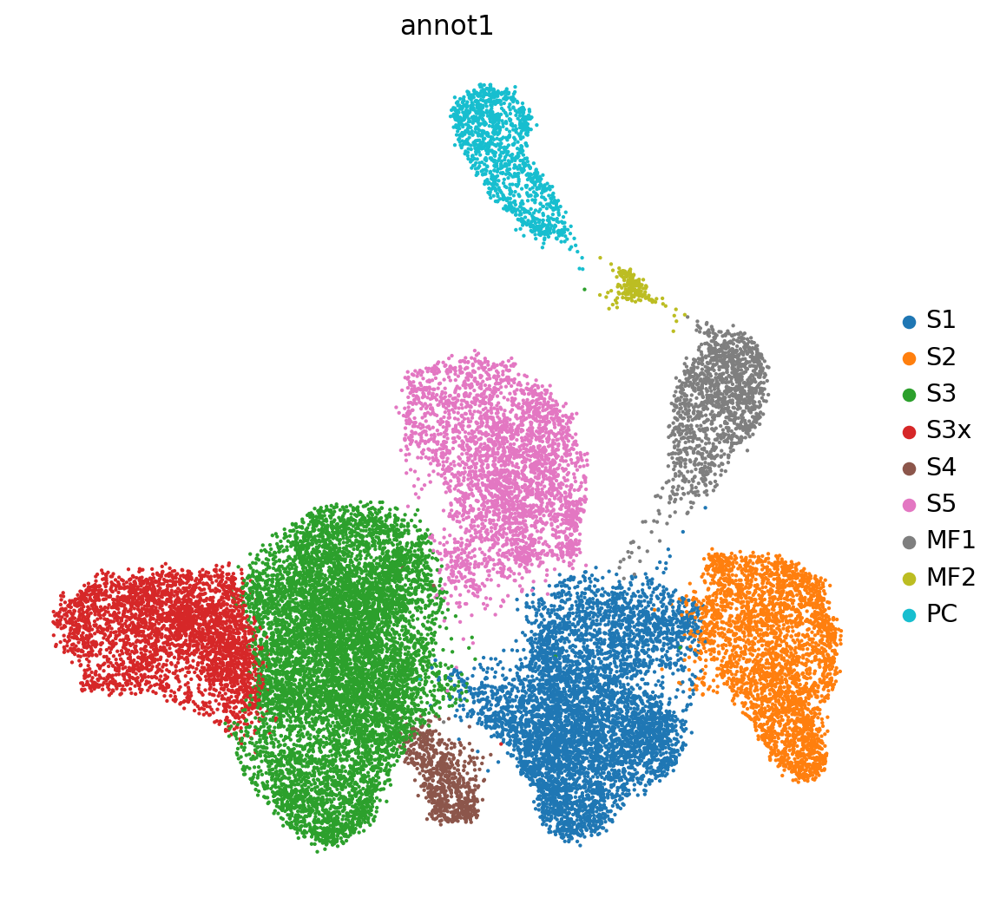

In [5]:
# Set up cell colors and check agreement of UMAP coordinates
sc.set_figure_params(dpi_save=300, figsize=(8, 8))

# without outline
sc.pl.umap(
    rna,
    color='annot1',
    palette='tab10',
    #palette=sc.plotting.palettes.vega_10_scanpy,  # color blind adjusted, vega10 same as tab10?
    frameon=False,
    size=15,  # point size
    #legend_loc='on data',
    #save='UMAP_ATAC_fibroblast_MF_PC.pdf'  # in ./figures
)

In [6]:
# Exclude to subset of cell types
rna = rna[rna.obs.annot1.isin(cell_subset)]

In [7]:
rna

View of AnnData object with n_obs × n_vars = 14573 × 17590
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full'
    uns: 'annot1_colors', 'leiden', 'neighbors', 'neighbors_bk', 'pca', 'umap'
    obsm:

In [58]:
rna.var.index[rna.var.index.str.contains("FOS")]

Index(['FOSL2', 'FOS', 'FOSB'], dtype='object', name='index')

In [8]:
# Recompute highly variable genes for subset
#sc.pp.highly_variable_genes(rna, n_top_genes=1500)

In [9]:
#sc.pp.pca(rna)

In [10]:
#sc.set_figure_params(dpi_save=300, figsize=(7, 7.0))
#sc.pl.embedding(rna, basis="pca", color="annot1", title="scRNA-seq")

In [11]:
sc.pp.neighbors(rna, n_neighbors=20)

In [12]:
rna

AnnData object with n_obs × n_vars = 14573 × 17590
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full'
    uns: 'annot1_colors', 'leiden', 'neighbors', 'neighbors_bk', 'pca', 'umap'
    obsm: 'X_pca'

## Diffusion pseudotime test

In [13]:
# sc.tl.diffmap(rna)


In [14]:
# sc.set_figure_params(dpi_save=300, figsize=(5, 5))

# root_ixs = rna.obsm["X_diffmap"][:, 0].argmin()
# sc.pl.scatter(
#     rna,
#     basis="diffmap",
#     color=["annot1"],
#     components=[1, 2],
# )

# rna.uns["iroot"] = root_ixs

In [15]:
#rna.uns['']

In [16]:
#sc.tl.dpt(rna, n_branchings=1, n_dcs=5)

# recompute UMAP


In [17]:
sc.tl.umap(rna)

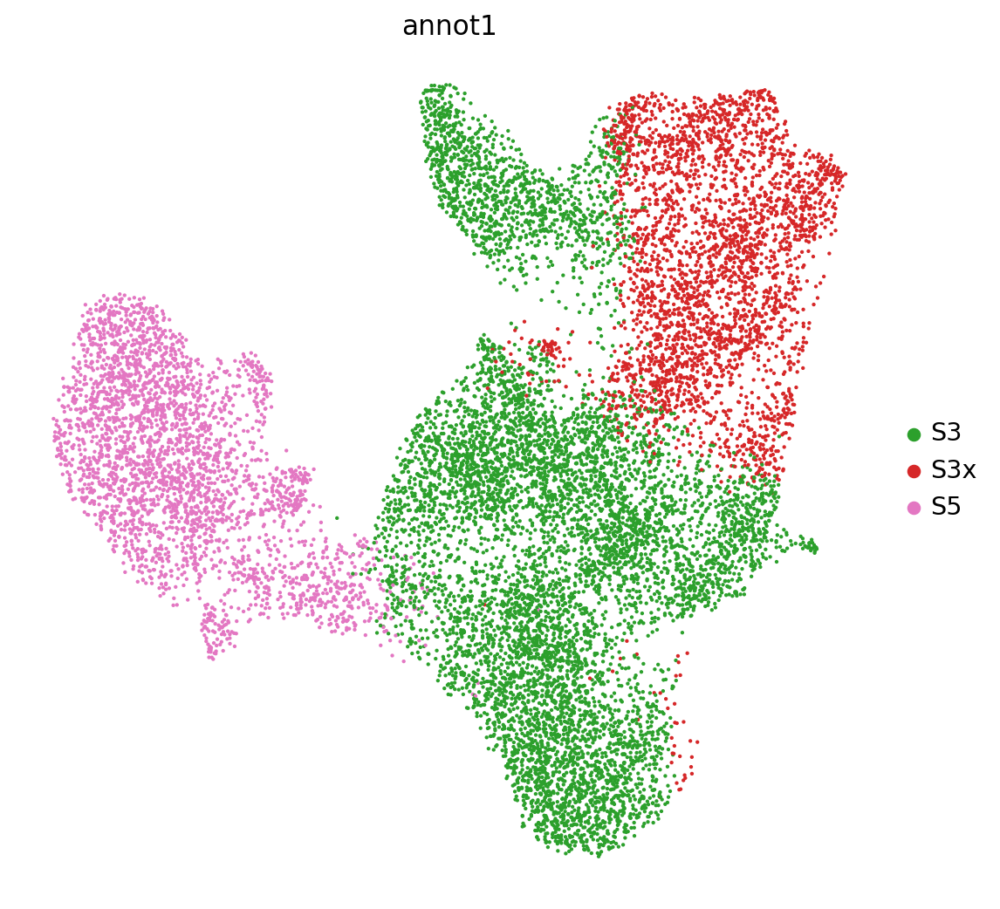

In [18]:
# plot new UMAP
sc.set_figure_params(dpi_save=300, figsize=(8, 8))

sc.pl.umap(
    rna,
    color='annot1',
    frameon=False,
    size=15,  # point size
    #legend_loc='on data',
    #save='UMAP_ATAC_fibroblast_MF_PC.pdf'  # in ./figures
)

In [19]:
# scFates graph on pca representation
scf.tl.tree(rna, method="ppt", Nodes=15, use_rep="pca",
            device="cpu", seed=1, ppt_lambda=100, ppt_sigma=0.025, ppt_nsteps=200)

inferring a principal tree --> parameters used 
    15 principal points, sigma = 0.025, lambda = 100, metric = euclidean
    fitting:  24%|██▍       | 48/200 [00:02<00:07, 19.19it/s]
    converged
    finished (0:00:02) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


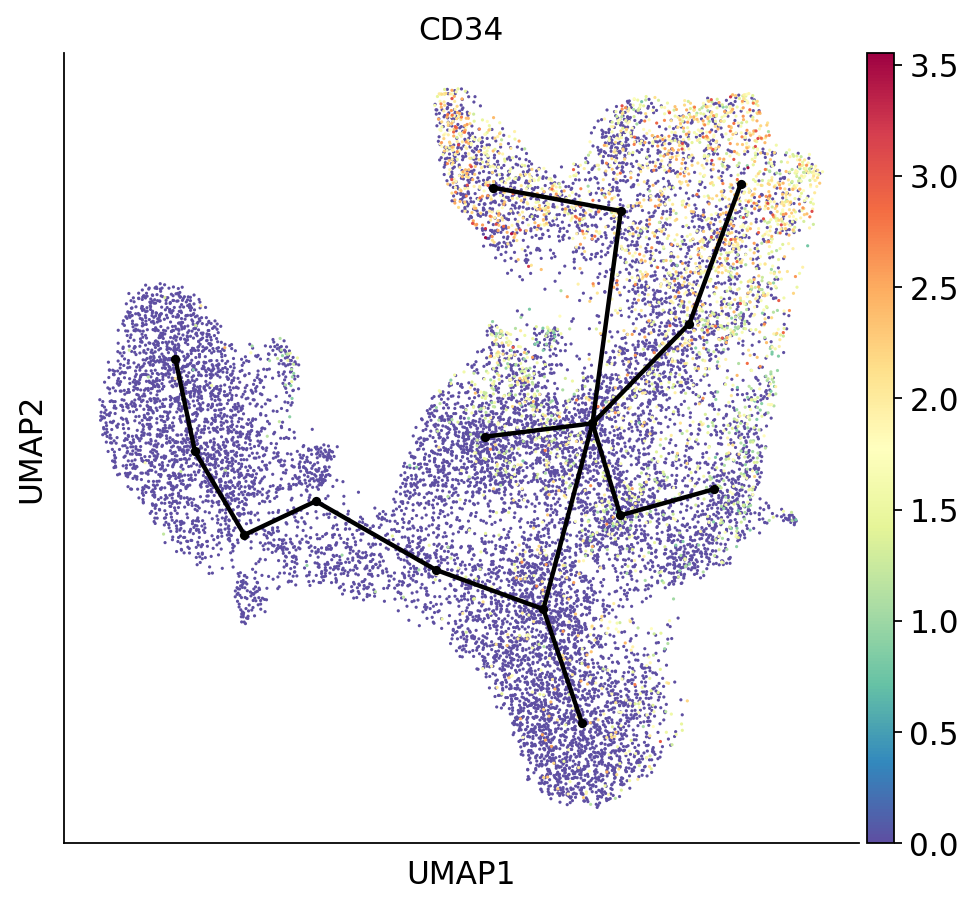

In [20]:
sc.set_figure_params(dpi_save=300, figsize=(7, 6.5))

scf.pl.graph(rna, color_cells="CD34", tips=False, forks=False, size_nodes=10, alpha_seg=1.0, basis="umap", cmap="Spectral_r",
             save="_RNA_scFates_PCA_CD34_" + name + ".pdf"
)

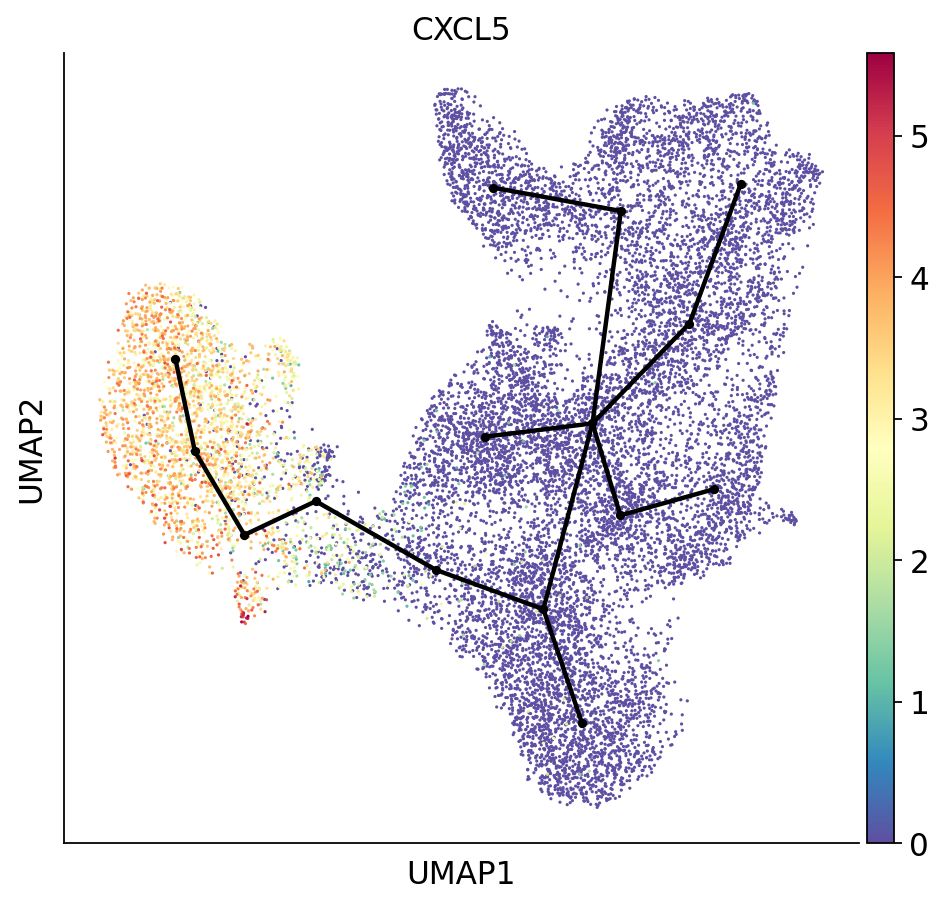

In [21]:
scf.pl.graph(rna, color_cells="CXCL5", tips=False, forks=False, size_nodes=10, alpha_seg=1.0, basis="umap", cmap="Spectral_r",
             save="_RNA_scFates_PCA_CXCL5_" + name + ".pdf")

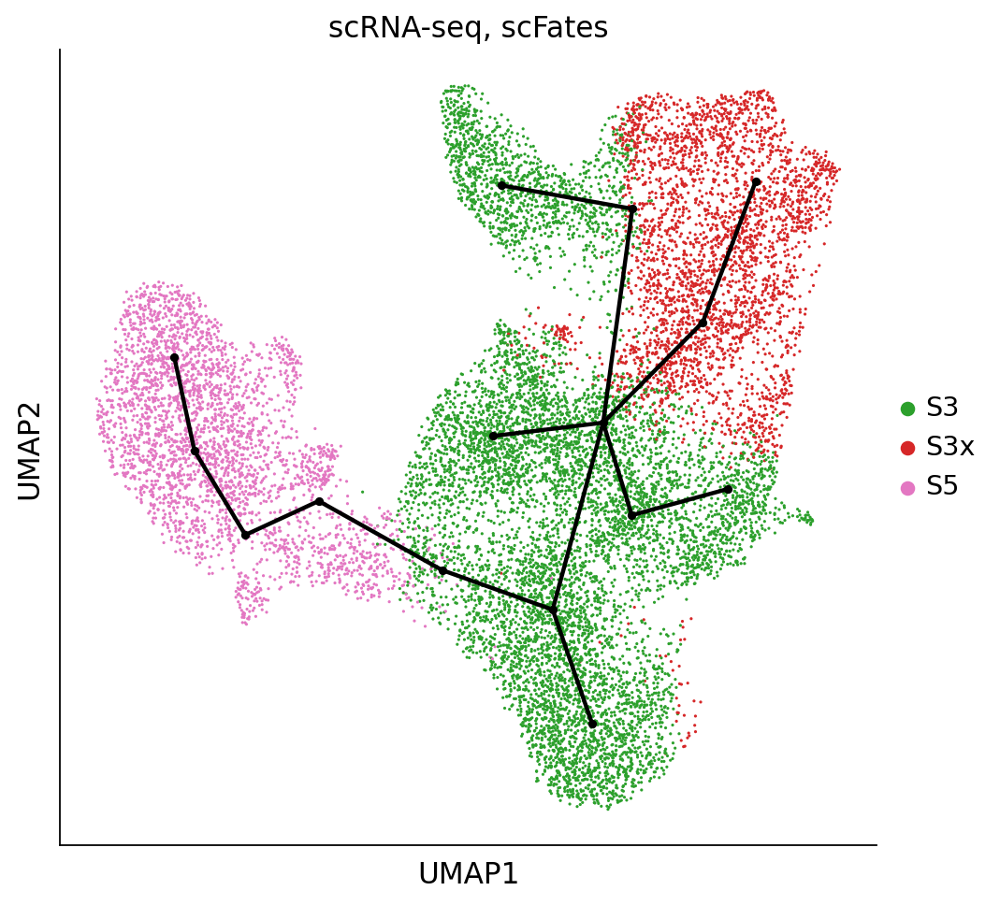

In [22]:
sc.set_figure_params(dpi_save=300, figsize=(7, 7.0))

scf.pl.graph(rna, color_cells="annot1", tips=False, forks=False, size_nodes=10, alpha_seg=1.0, basis="umap",
             title="scRNA-seq, scFates",
             save="_RNA_scFates_PCA_annot_" + name + ".pdf")

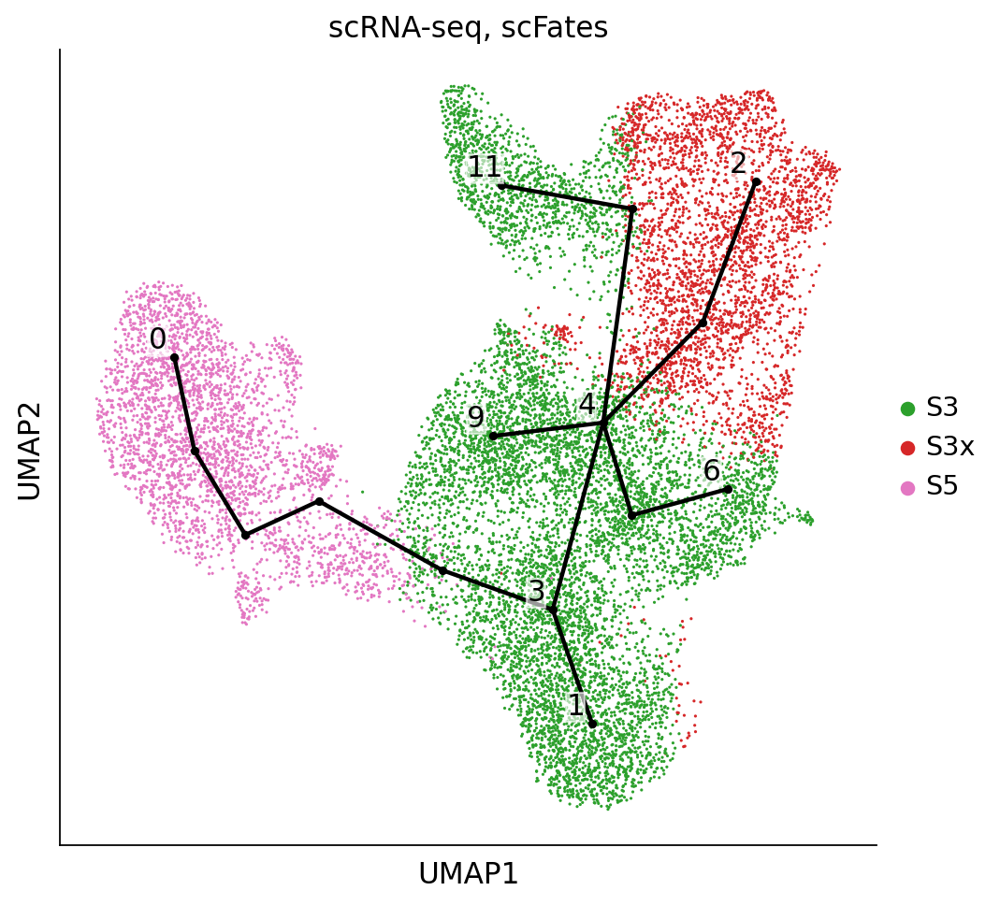

In [23]:
# Plot node numbers
scf.pl.graph(rna, color_cells="annot1", tips=True, size_nodes=10, alpha_seg=1.0, basis="umap",
             title="scRNA-seq, scFates")

In [24]:
# # On Single segment hypothesis 
# scf.tl.curve(rna, Nodes=30, use_rep="pca", ndims_rep=20)

# scf.pl.graph(rna, basis="umap")

In [25]:
# set root and calculate global pseudotime
scf.tl.root(rna, 2)  # CD34

node 2 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.


In [26]:
#rna.uns['graph']

In [27]:
%env PYTHONWARNINGS=ignore::FutureWarning

# Not sure why these fail

#import warnings
#warnings.filterwarnings('ignore')
#warnings.simplefilter('ignore')

#scf.tl.pseudotime(rna, n_jobs=8, n_map=100, seed=42)
#scf.tl.pseudotime(rna, n_jobs=20, n_map=100, seed=42)
scf.tl.pseudotime(rna, n_jobs=8, n_map=1, seed=42)
#scf.tl.pseudotime(rna, n_jobs=1, n_map=1, seed=42)

env: PYTHONWARNINGS=ignore::FutureWarning
projecting cells onto the principal graph
    finished (0:00:13) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


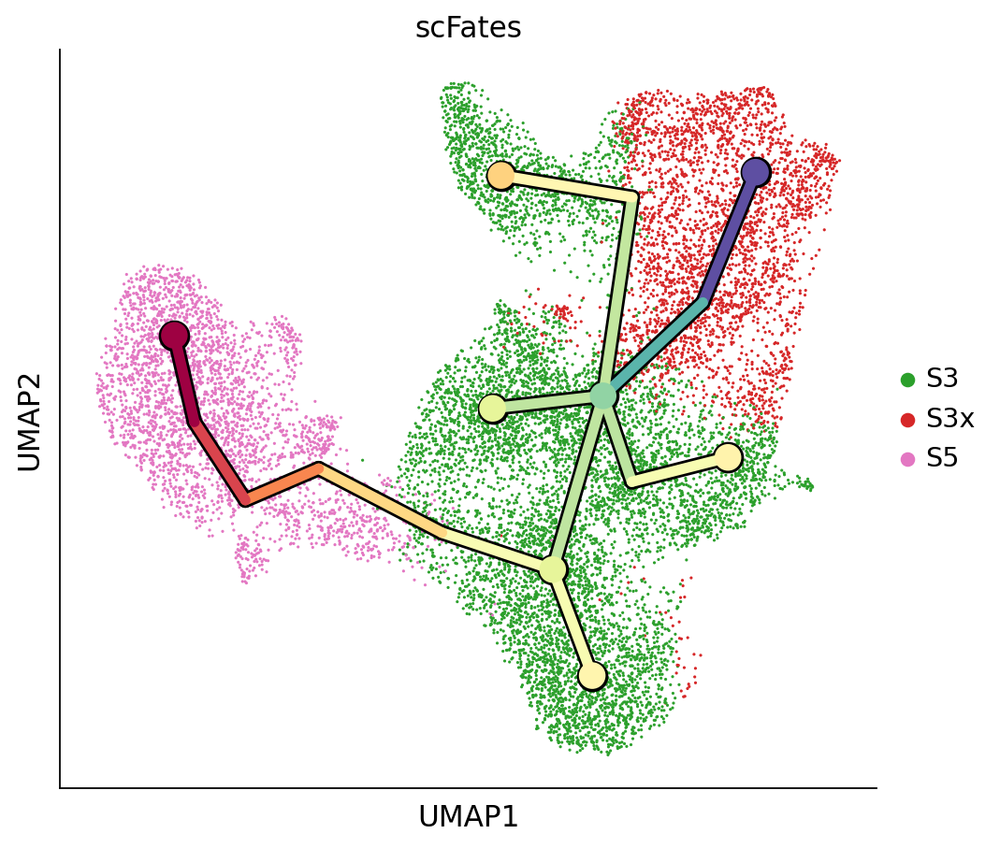

In [28]:
sc.set_figure_params(dpi_save=300, figsize=(7, 6.5))

scf.pl.trajectory(rna, cmap_seg="Spectral_r", color_cells="annot1", title="scFates",
                  save="_RNA_trajectory_" + name + ".pdf"
)

In [29]:
#scf.tl.dendrogram(rna)

In [30]:
#sc.set_figure_params(dpi_save=300, figsize=(3, 7))

#scf.pl.dendrogram(rna, color="annot1", linewidth_seg=1, tree_behind=True, alpha_seg=0.8, title="", save="_RNA_scFates_S3S5.pdf")


In [31]:
scf.tl.test_association(rna, n_jobs=1)  # was 12, long runtime: 4h


test features for association with the trajectory
    single mapping : 100%|██████████| 17590/17590 [4:47:52<00:00,  1.02it/s]  
    found 6508 significant features (4:47:52) --> added
    .var['p_val'] values from statistical test.
    .var['fdr'] corrected values from multiple testing.
    .var['st'] proportion of mapping in which feature is significant.
    .var['A'] amplitue of change of tested feature.
    .var['signi'] feature is significantly changing along pseudotime.
    .uns['stat_assoc_list'] list of fitted features on the graph for all mappings.


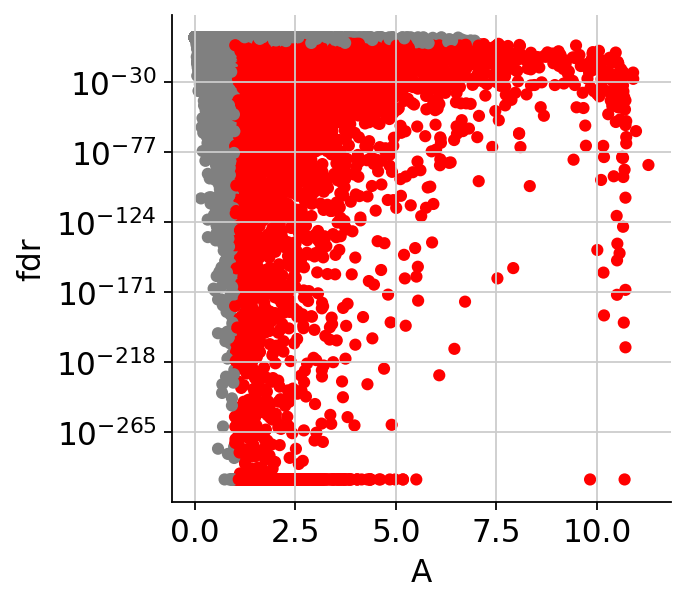

In [32]:
sc.set_figure_params()
scf.pl.test_association(rna)

In [33]:
%env PYTHONWARNINGS=ignore::FutureWarning

scf.tl.fit(rna, n_jobs=1)  # was 8

env: PYTHONWARNINGS=ignore::FutureWarning
fit features associated with the trajectory
    single mapping : 100%|██████████| 6508/6508 [3:53:07<00:00,  2.15s/it]  
    finished (adata subsetted to keep only fitted features!) (3:53:29) --> added
    .layers['fitted'], fitted features on the trajectory for all mappings.
    .raw, unfiltered data.


In [34]:

#tab = rna.var.copy()

In [35]:
# Inspect table of genes associated with. pseudotime
tab = rna.var.copy()

#tab = tab.sort_values(by="A", ascending=False)

tab = tab.sort_values(by="p_val")

tab.head(50)

,gene_ids,mito,ribo,hb,n_counts,n_cells,cc,highly_variable,highly_variable_nbatches,hvg_full,p_val,A,fdr,st,signi
index,,,,,,,,,,,,,,,
OMD,ENSG00000127083,False,False,False,3441.0,2222,False,True,4,True,0.0,5.177454,0.0,1,True
FOS,ENSG00000170345,False,False,False,703189.0,34776,False,False,0,False,0.0,1.763134,0.0,1,True
FBXO32,ENSG00000156804,False,False,False,11928.0,5434,False,True,12,True,0.0,2.754393,0.0,1,True
COL14A1,ENSG00000187955,False,False,False,59073.0,15937,False,True,6,True,0.0,2.507434,0.0,1,True
NOV,ENSG00000136999,False,False,False,1972.0,780,False,True,13,True,0.0,1.459221,0.0,1,True
TNFRSF11B,ENSG00000164761,False,False,False,3525.0,777,False,True,8,True,0.0,1.761608,0.0,1,True
CTHRC1,ENSG00000164932,False,False,False,22782.0,9336,False,True,9,True,0.0,1.845322,0.0,1,True
NCALD,ENSG00000104490,False,False,False,4242.0,3087,False,True,5,True,0.0,1.540031,0.0,1,True
PFN1,ENSG00000108518,False,False,False,87241.0,27172,False,False,0,False,0.0,1.631256,0.0,1,True


In [36]:
rna.obs.head()

,doublet_bh_pval,n_counts,sample_id,scrublet_score,log1p_n_counts,n_genes,log1p_n_genes,percent_mito,percent_ribo,percent_hb,...,leiden_bk_split3,annot1,leiden_bk_split4,annot_gut_lr,annot_gut_lr_prob,broad_annot1,t,seg,edge,milestones
index,,,,,,,,,,,,,,,,,,,,,
AAACGAAGTTCCGTTC-R01,0.737696,1707.0,R01,0.167630,7.443079,920,6.825460,10.369068,6.268307,0.0,...,4,S3x,4,WNT2B+ Fos-hi,0.294068,S3x,16.118999,4,4|3,4
AAACGCTGTCGTTGGC-R01,0.737696,1959.0,R01,0.029213,7.580700,916,6.821107,8.524757,7.197550,0.0,...,4,S3x,4,RSPO3+,0.274607,S3x,8.098265,3,5|2,4
AAAGGGCTCCAAGGGA-R01,0.737696,1571.0,R01,0.103734,7.360104,877,6.777647,11.075747,12.476130,0.0,...,"0,0",S3,"0,0",RSPO3+,0.372482,S3,22.306026,5,14|4,4
AAAGTCCGTACGATGG-R01,0.737696,9147.0,R01,0.314286,9.121290,2879,7.965546,3.345359,18.137094,0.0,...,"0,0",S3,"0,0",WNT2B+ Fos-hi,0.219569,S3,22.306026,5,14|4,4
AAATGGAAGGATCATA-R01,0.737696,3557.0,R01,0.122970,8.176954,1398,7.243513,7.534439,15.181333,0.0,...,"0,0",S3,"0,0",WNT2B+ Fos-hi,0.308136,S3,22.306026,5,14|4,4


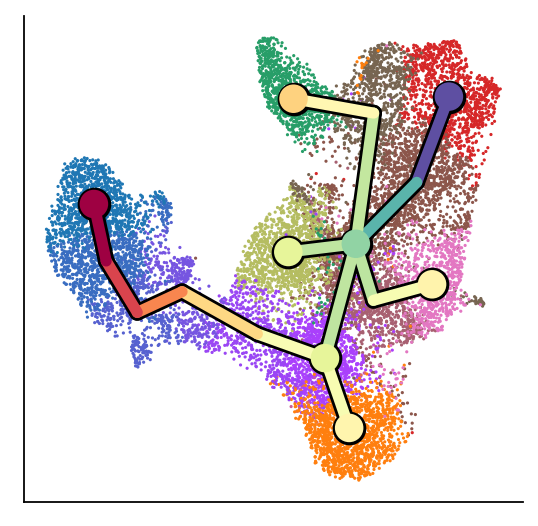

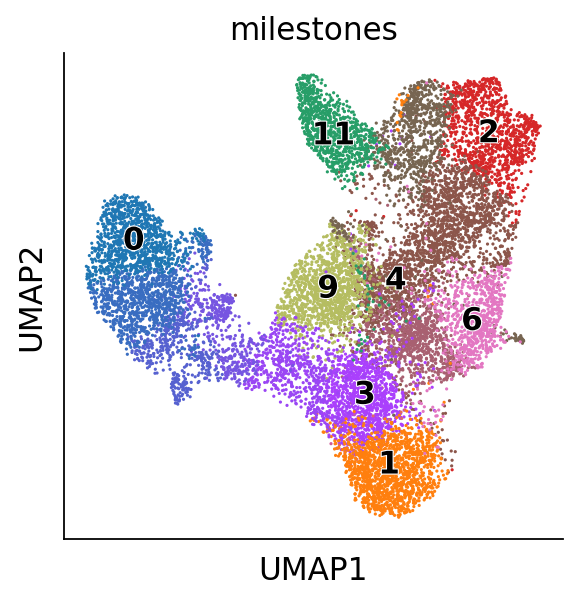

In [38]:
# Milestones map
sc.set_figure_params(dpi_save=300, figsize=(4, 4))

scf.pl.trajectory(rna, cmap_seg="Spectral_r", color_cells="milestones",
                  #title="scFates",
                  title="scFate milestones",
                  save="_RNA_trajectory_milestones_" + name +".pdf"
)

scf.pl.milestones(rna, 
                  #show=False, 
                  annotate=True)

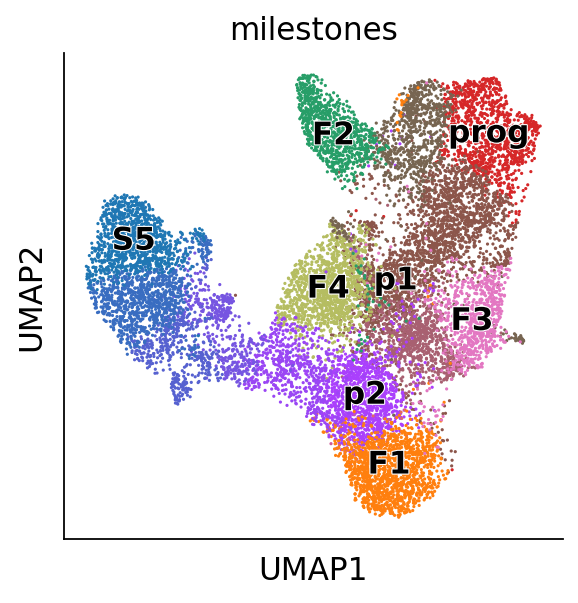

In [39]:
scf.tl.rename_milestones(rna, ["S5", "F1", "F2", "prog", "p2", "p1", "F3", "F4"])
scf.pl.milestones(rna, 
                  #show=False, 
                  annotate=True)

In [106]:
#exclude_markers = ["FOS", "NCALD"]
#tab.index.drop(exclude_markers)[0:50]

Index(['OMD', 'FBXO32', 'COL14A1', 'NOV', 'TNFRSF11B', 'CTHRC1', 'NCALD',
       'PFN1', 'LTBP1', 'VMO1', 'EMILIN1', 'HLA-A', 'OSR2', 'MATN2', 'CPQ',
       'SDC2', 'GEM', 'SRSF7', 'IER3', 'HLA-C', 'HLA-B', 'DDAH2', 'COX6C',
       'ZFP36L2', 'MYC', 'ZFP36', 'ALDH1A1', 'PMP22', 'MAMDC2', 'ADAMTS2',
       'AC005410.2', 'TPM2', 'CCL19', 'GAS7', 'HIF1A', 'RABAC1', 'WISP1',
       'ZFP36L1', 'ACTN1', 'SRSF5', 'APOD', 'LTBP4', 'LAPTM4A', 'RHOB',
       'SERTAD1', 'KDM6B', 'LY6H', 'LY6E', 'NFIB', 'ANXA1'],
      dtype='object', name='index')

In [160]:
#scf.tl.test_fork(rna, root_milestone="prog", milestones=["p1", "p2", "S5"], n_jobs=8, rescale=True)

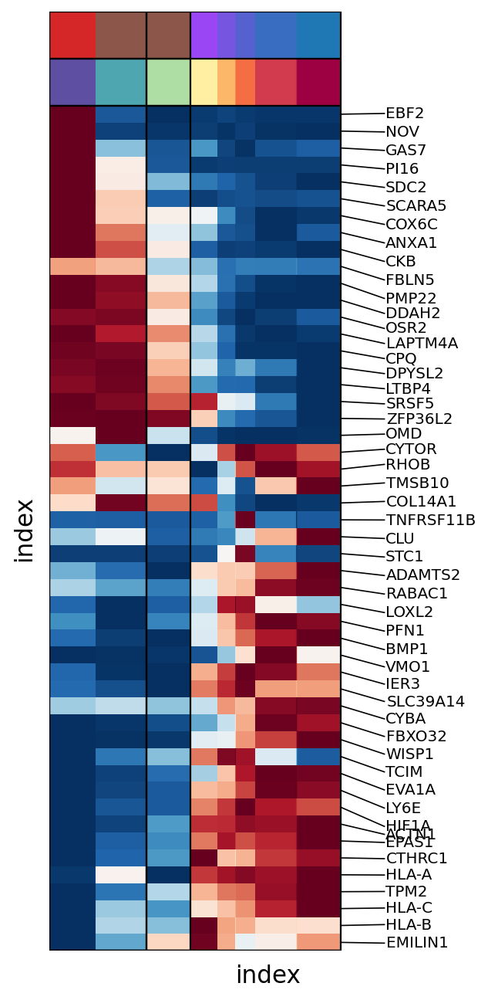

In [41]:
# Markers that are primarily detected in side branches, found among top 100
exclude_markers = ["FOS",               
    #"OMD", 
    "NCALD", "LTBP1", "MATN2", "SRSF7", 'MYC',
    'ZFP36',
    'ALDH1A1',
    'MAMDC2',
    'AC005410.2',
    'ZFP36L1',
    'APOD',
    'SERTAD1',
    'KDM6B',
    'LY6H',
    'NFIB',
    'PLEKHH2',
    'RARRES1',
    'MTHFD2',
    'TNFAIP2',
    'GPR132',
    'PTX3',
    'CCNL1',
    'JUND',
    'TIPARP',
    'CCL19',
    'GEM',
    'EIF5',
    'HSPA1B',
    'ADAMDEC1'
]

features = tab.index.drop(exclude_markers)[0:50]

# Heatmap of top genes
# For some reason this plots to ./figures/
scf.pl.trends(rna,
              features=features,
              n_features=50,  # features to highlight
              
              plot_emb=False,
              show_segs=True,
              annot="milestones",
              root_milestone="prog",
              milestones=["prog", "p1", "p2", "S5"],

              figsize=(5, 10),  # width, height
              pseudo_cmap="Spectral_r",
              save="_trajectory_core_selected_top50_" + name + "_v2.pdf"
)


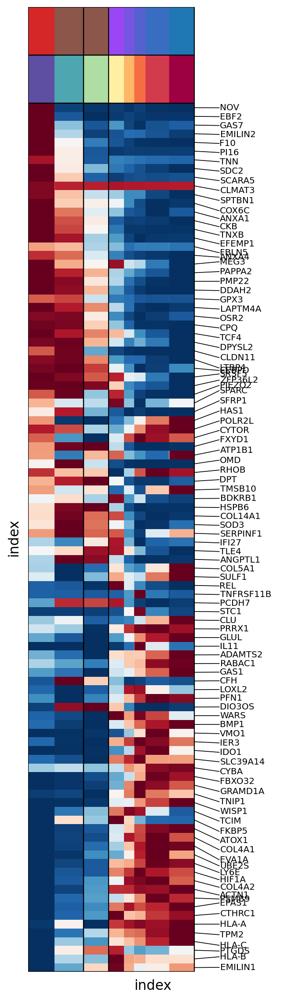

In [52]:
features = tab.index.drop(exclude_markers)[0:100]

# Heatmap of top genes
# For some reason this plots to ./figures/
scf.pl.trends(rna,
              features=features,
              n_features=100,  # features to highlight
              
              plot_emb=False,
              show_segs=True,
              annot="milestones",
              root_milestone="prog",
              milestones=["prog", "p1", "p2", "S5"],

              figsize=(5, 18),  # width, height
              pseudo_cmap="Spectral_r",
              save="_trajectory_core_selected_top100_" + name + "_v2.pdf"
)

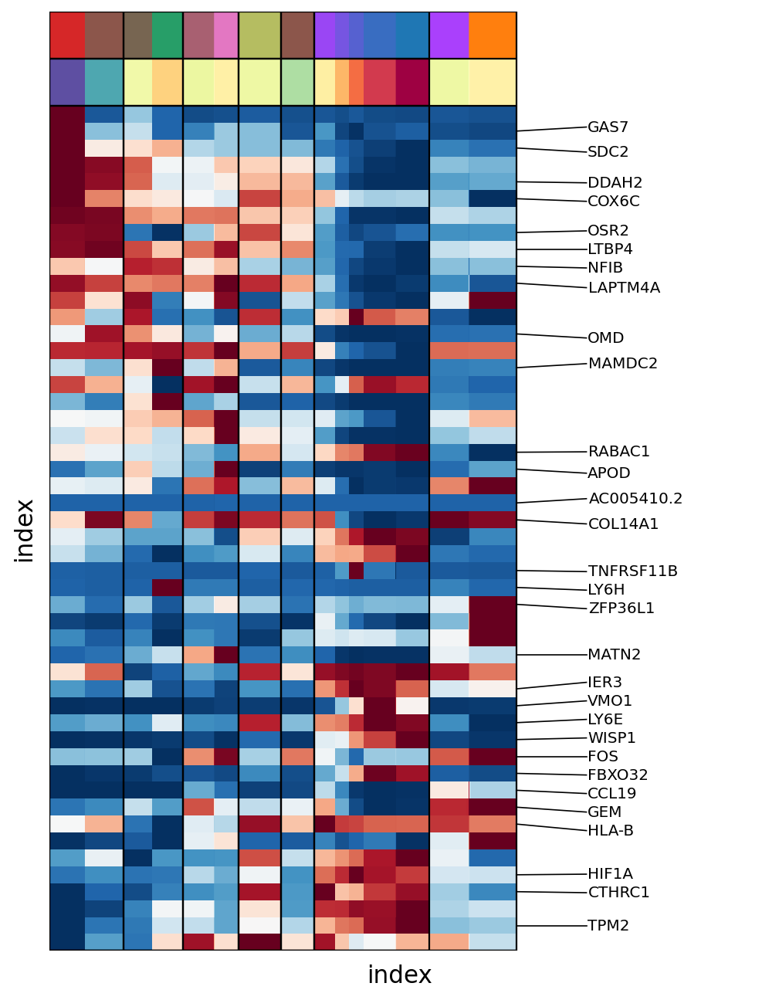

In [241]:
# Heatmap of all 
features=tab.head(50).index  # all top markers

# Heatmap of top genes
# For some reason this plots to ./figures/
scf.pl.trends(rna,
              features=features,
              n_features=30,  # features to highlight
              
              plot_emb=False,
              show_segs=True,
              annot="milestones",
              root_milestone="prog",
              #milestones=["prog", "p1", "p2", "F1", "F2", "F3", "F4", "S5"],

              figsize=(8, 10),  # width, height
              pseudo_cmap="Spectral_r",
              save="_trajectory_all_top50_" + name + ".pdf"
)

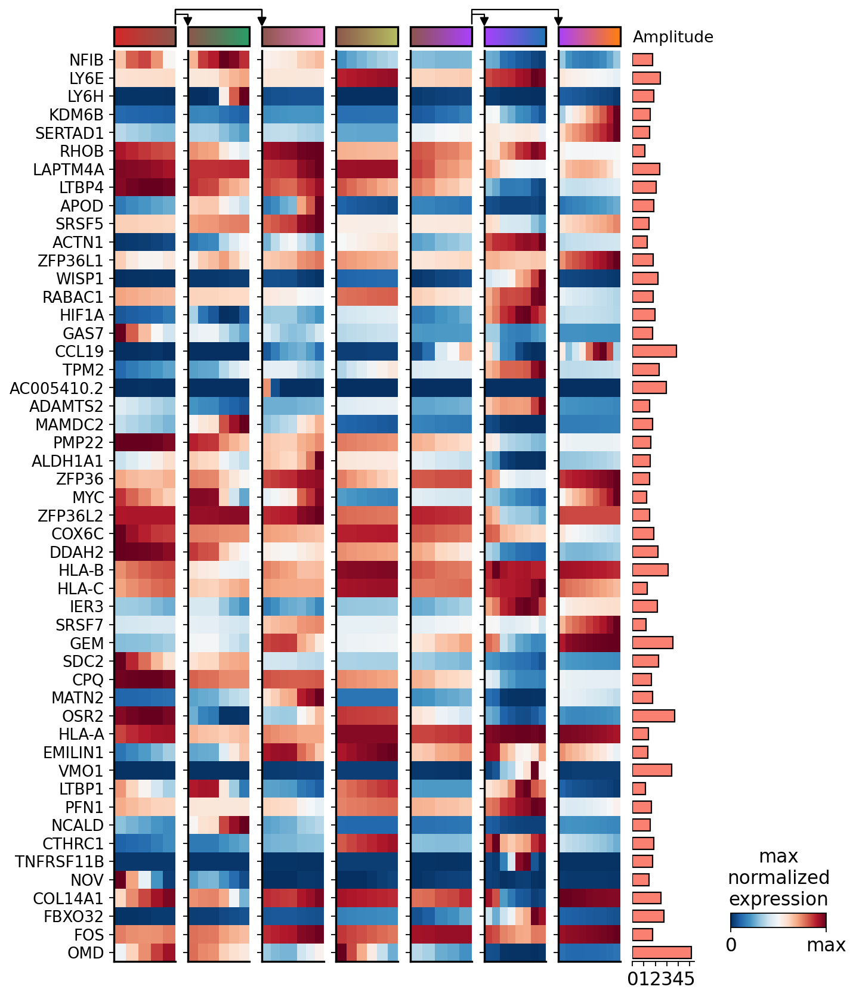

In [242]:
scf.pl.matrix(rna, features=features, cmap="RdBu_r", nbins=10, annot_var=True, save="_trajectory_all_top50_" + name + ".pdf")

In [74]:
#sc.pl.dpt_groups_pseudotime(rna)

In [75]:
#rna.obs['dpt_order_indices'] = rna.obs.t

In [76]:
#sc.pl.dpt_timeseries(rna, dpt_timeseries)

In [42]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

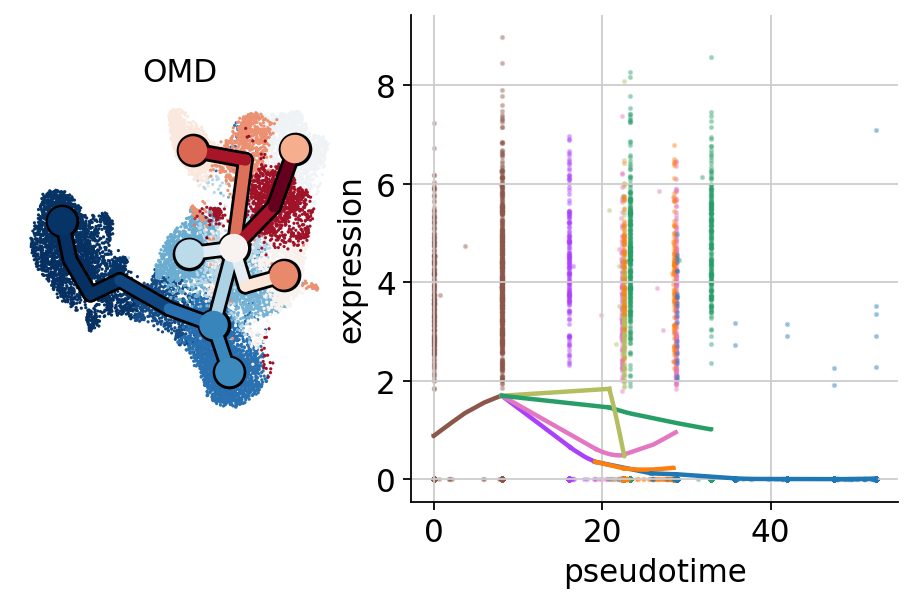

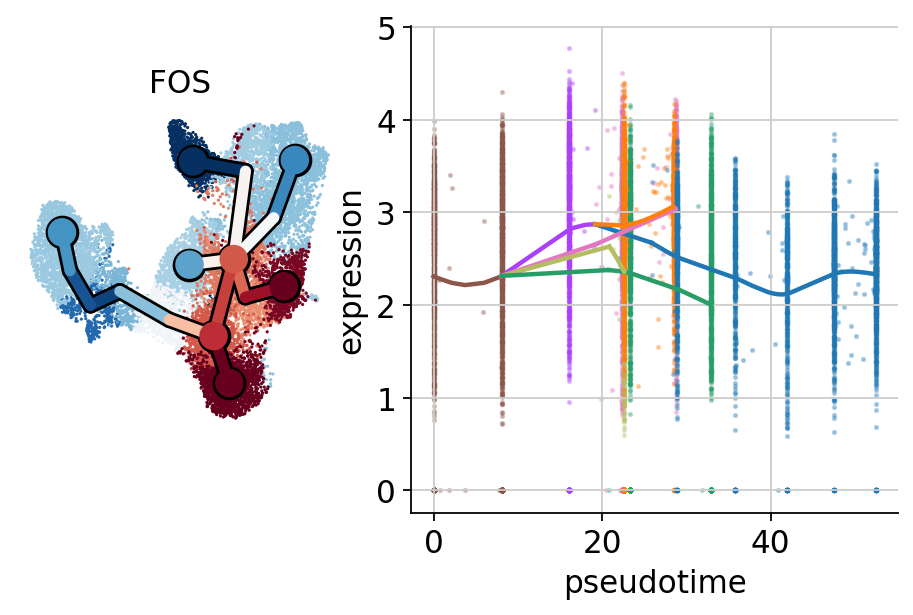

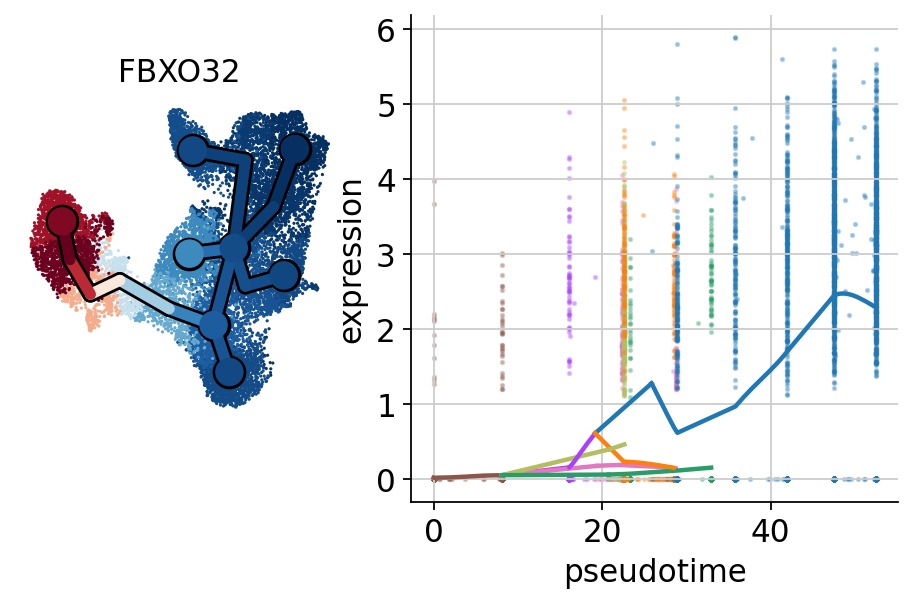

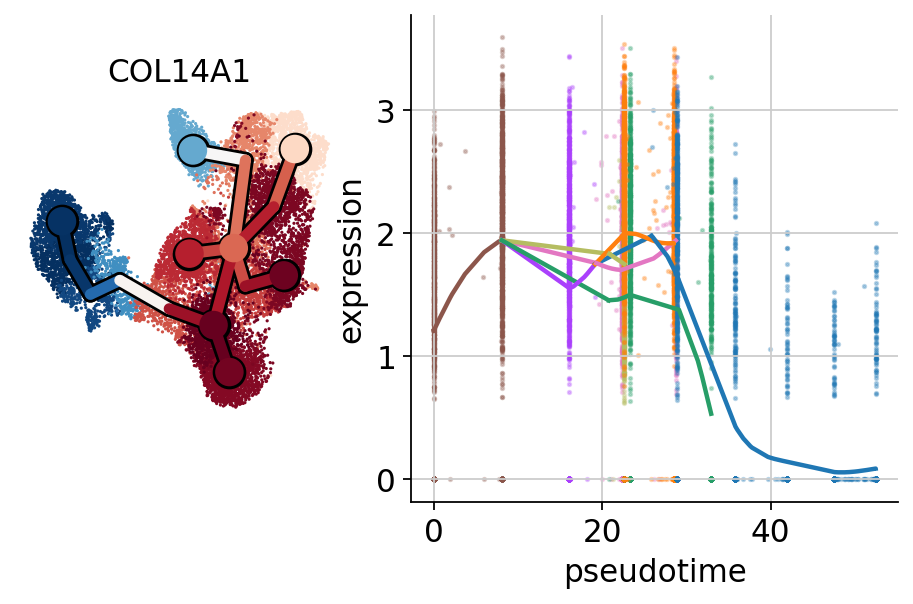

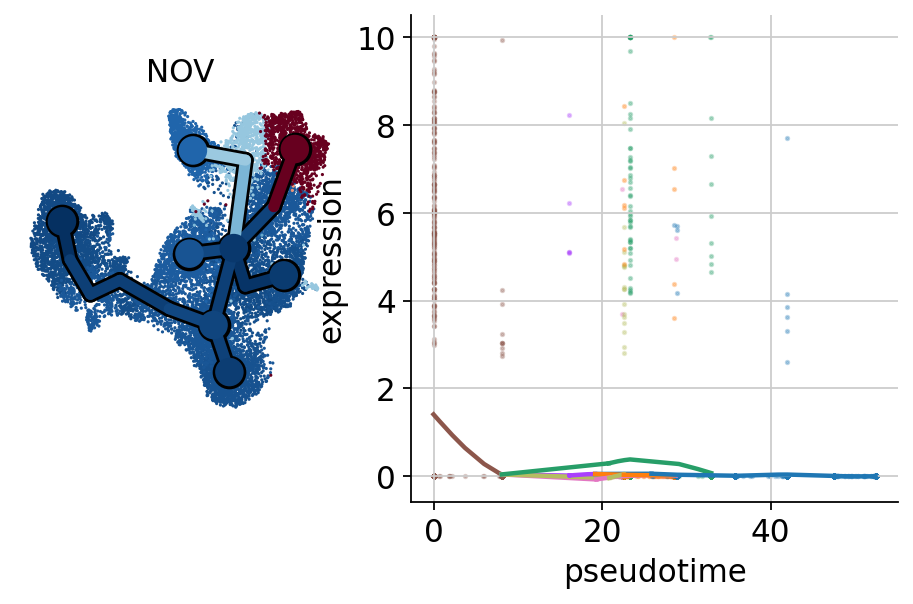

...

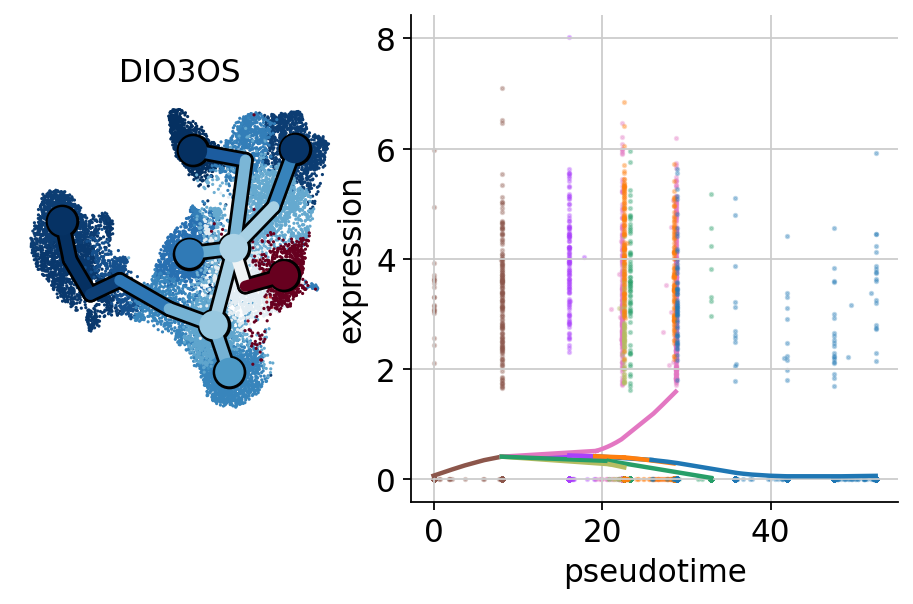

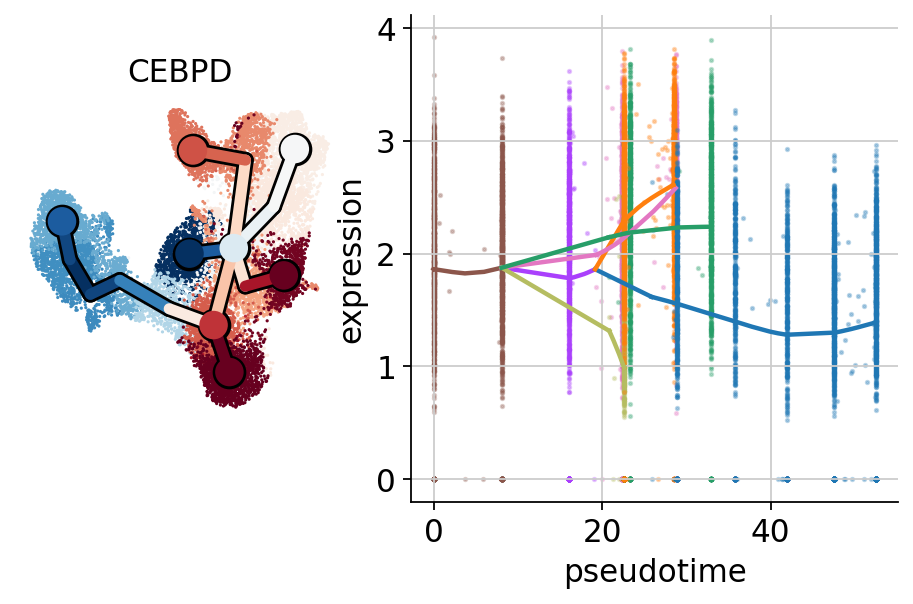

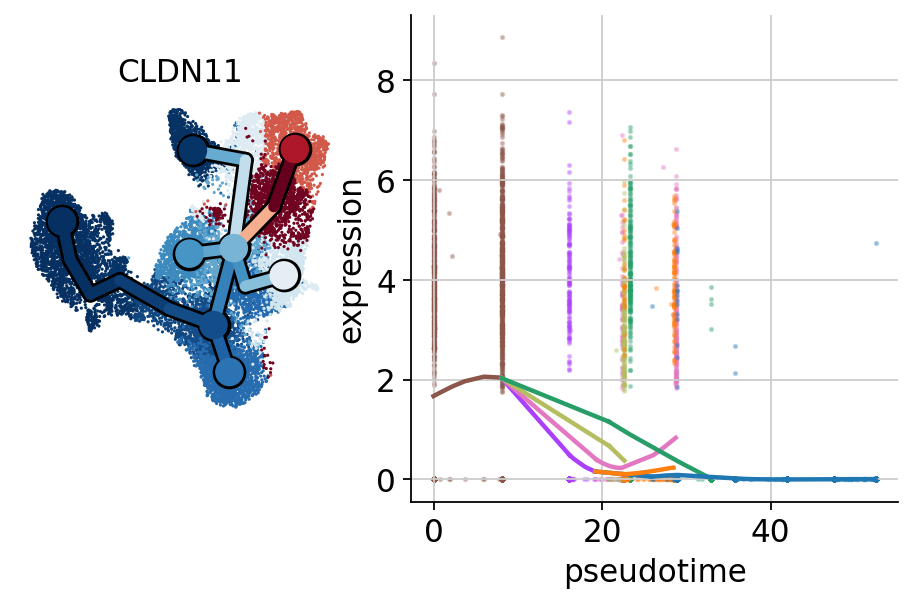

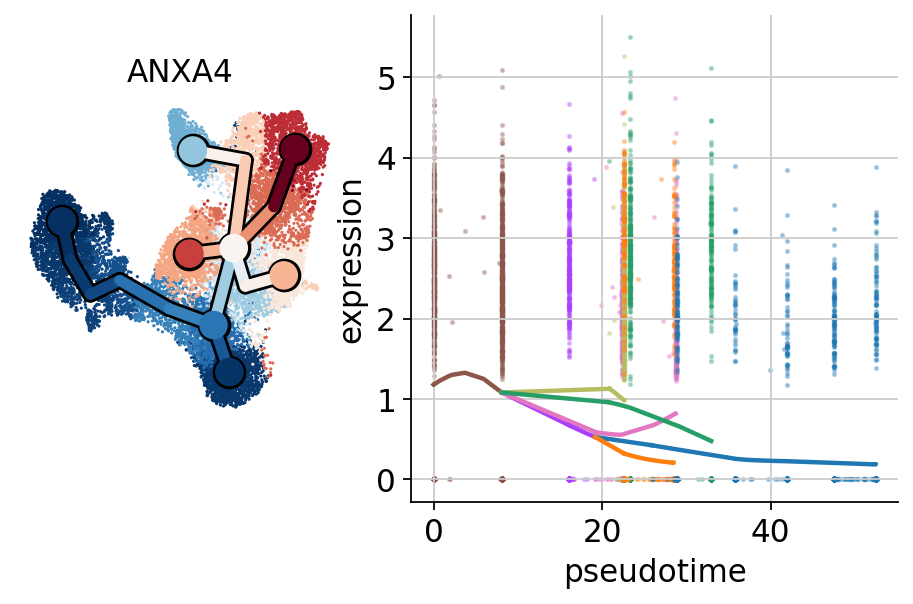

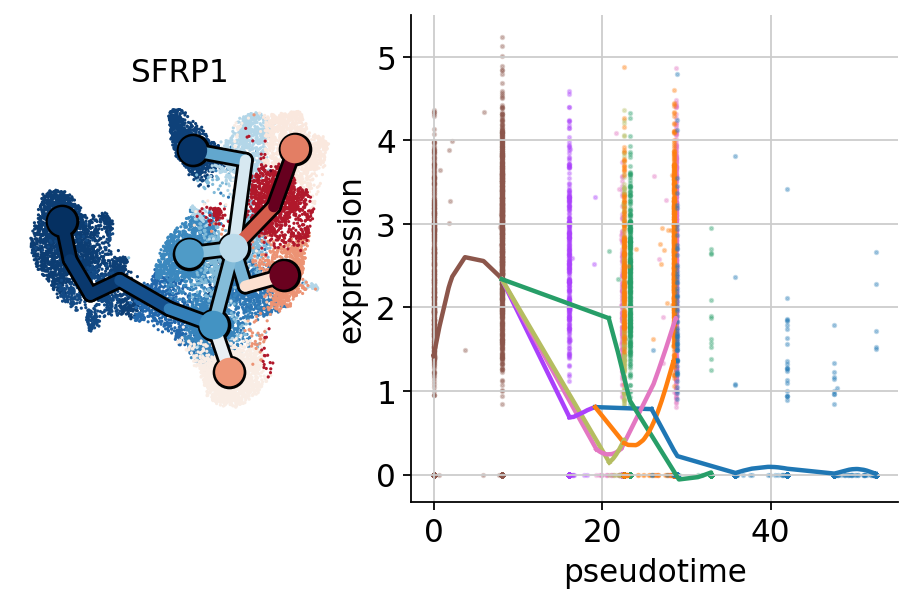

In [111]:
sc.set_figure_params(figsize=(2, 4),frameon=False)

for gene in tab.index[0:100]:
    scf.pl.single_trend(rna, gene, wspace=-.15)

In [43]:
#name

'S3xS3S5'

In [46]:
#rna

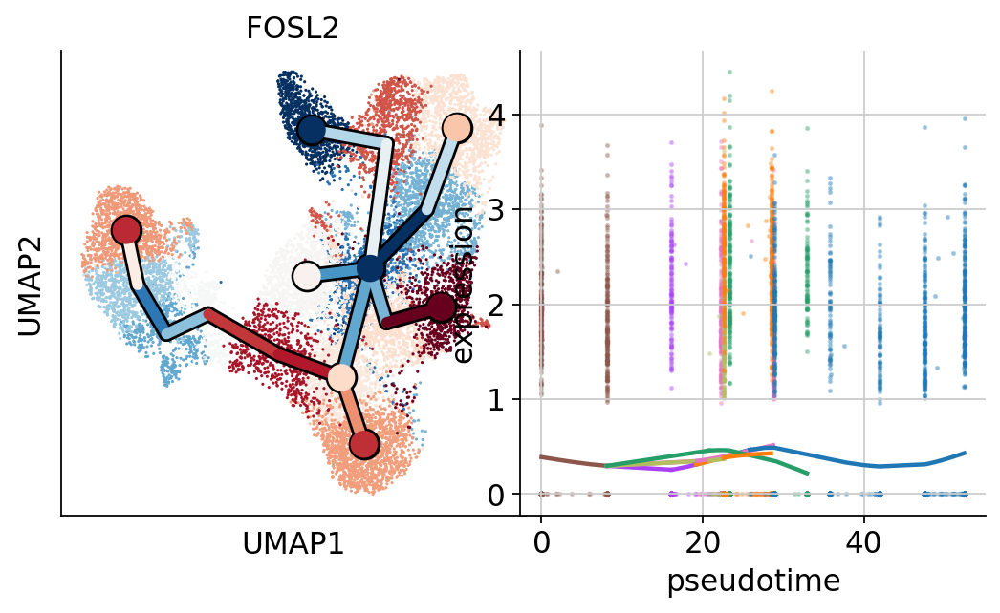

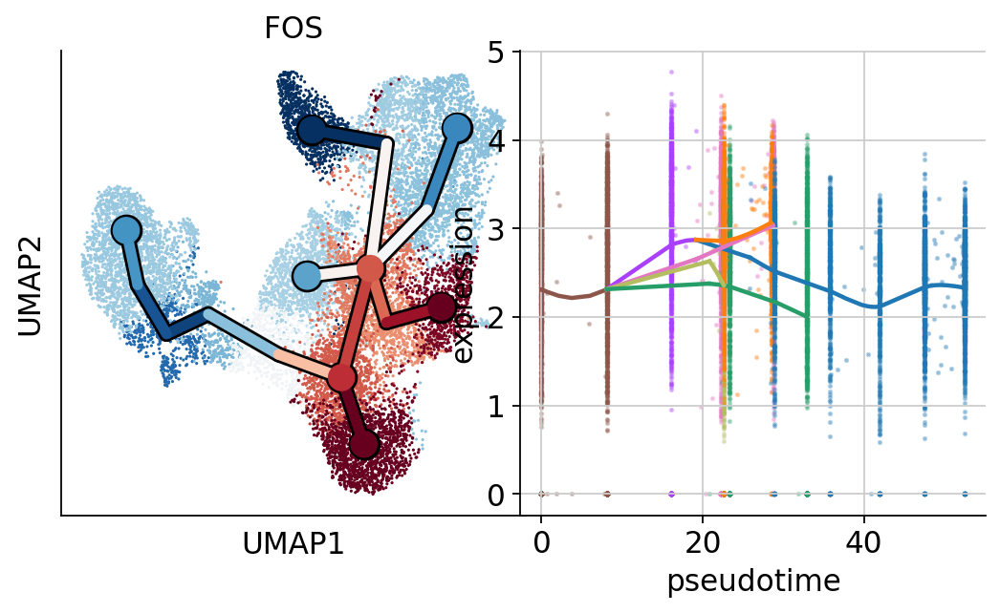

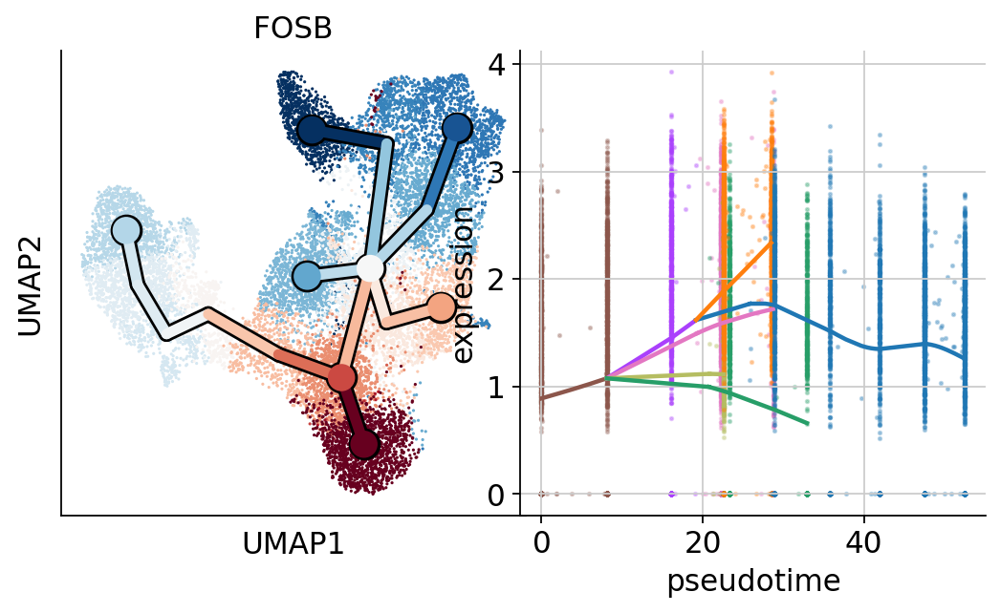

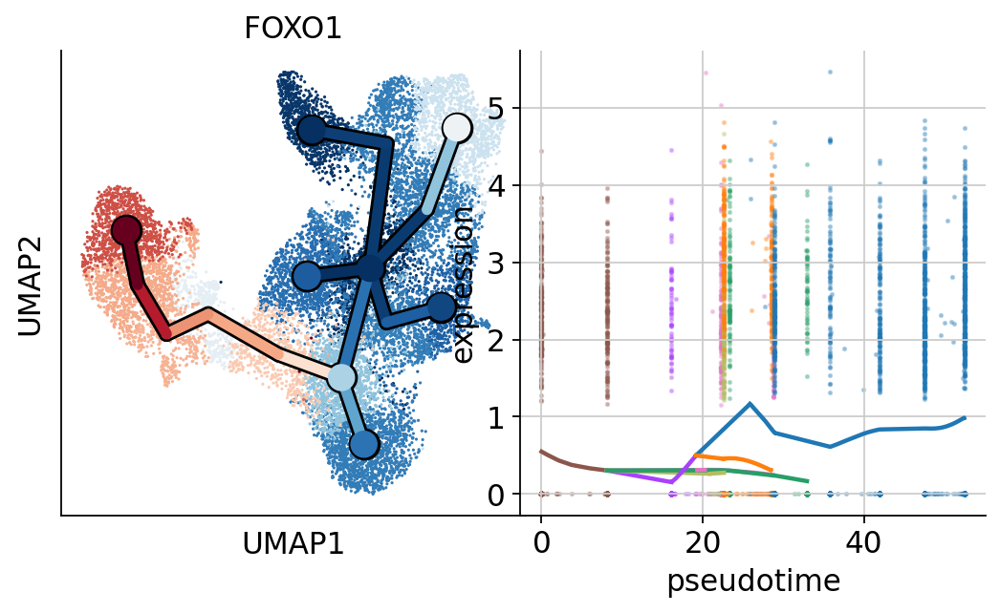

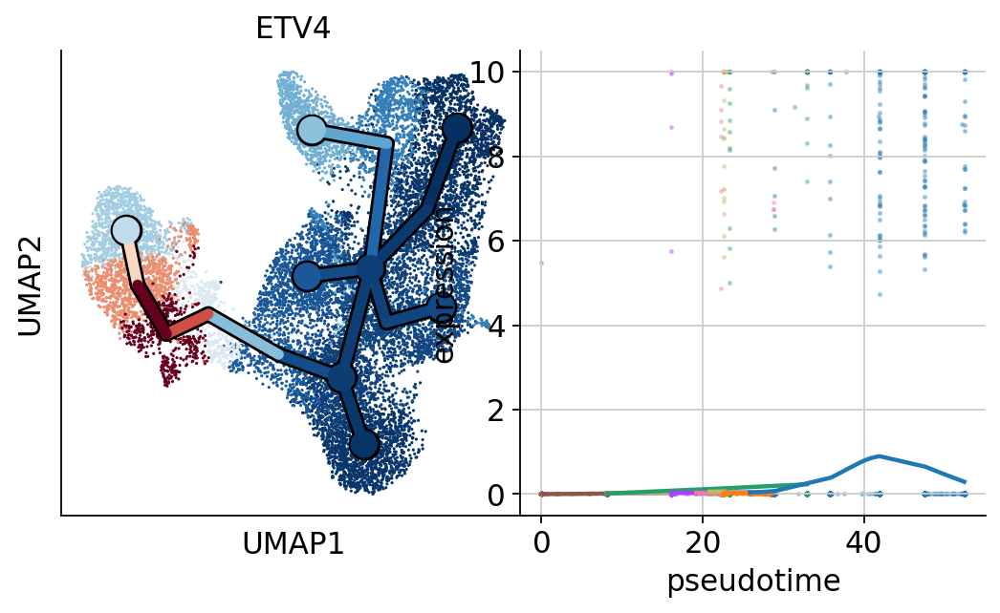

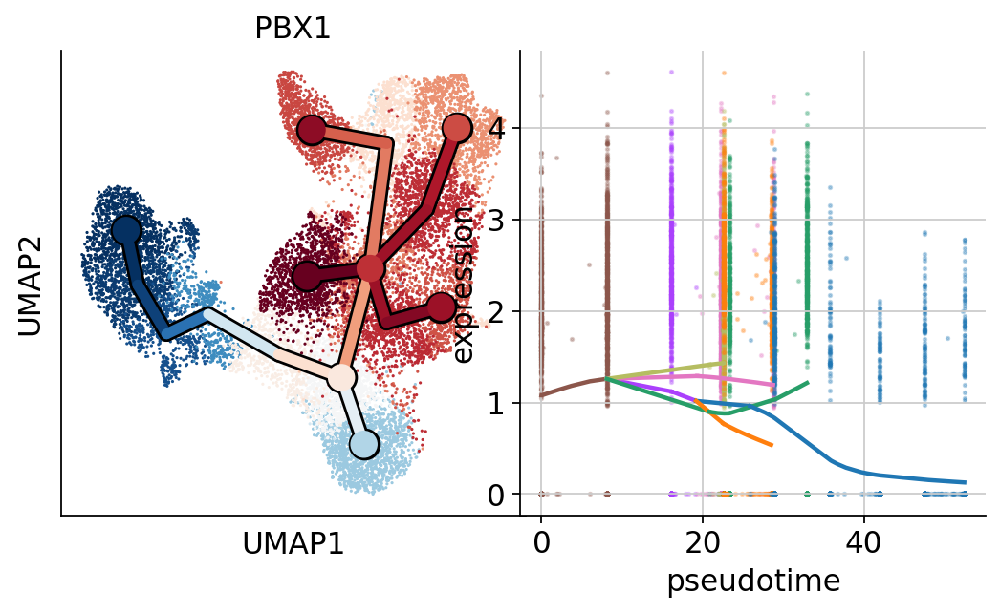

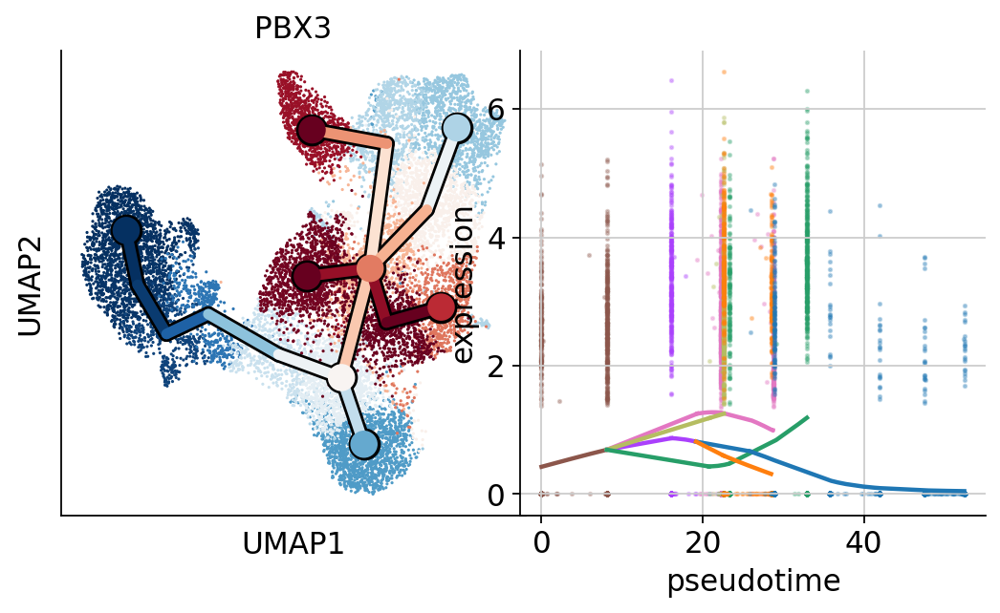

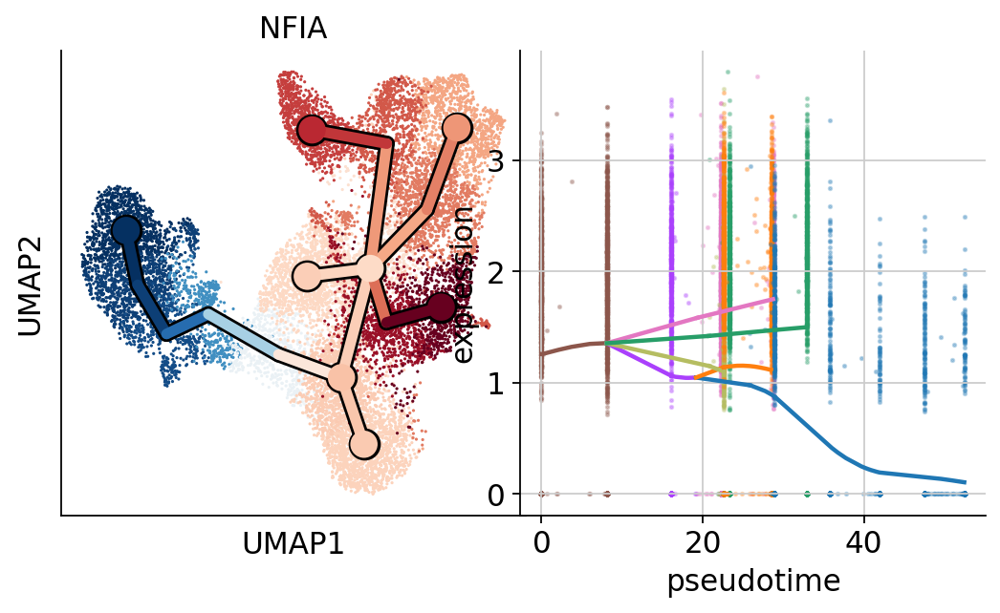

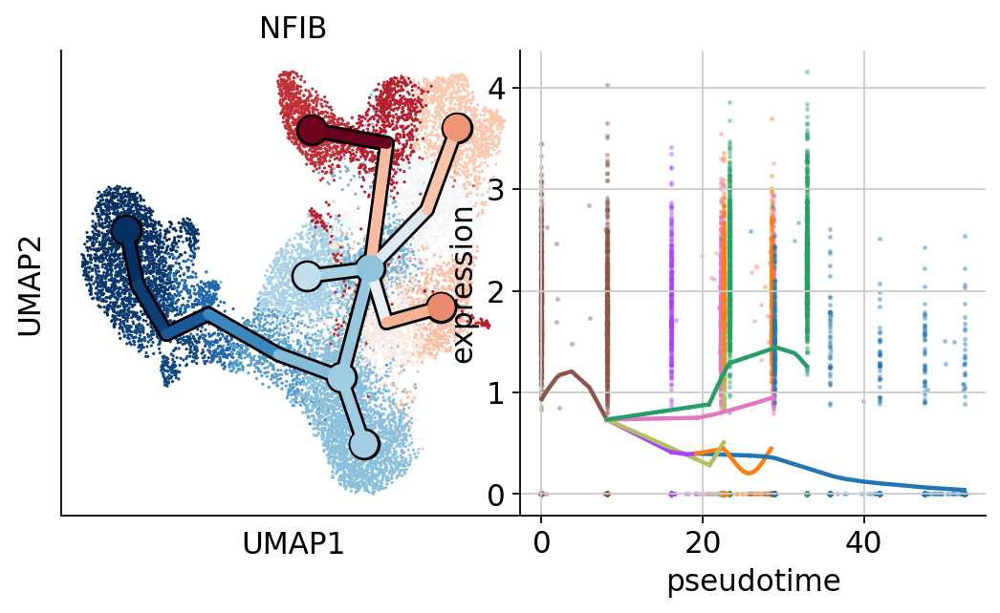

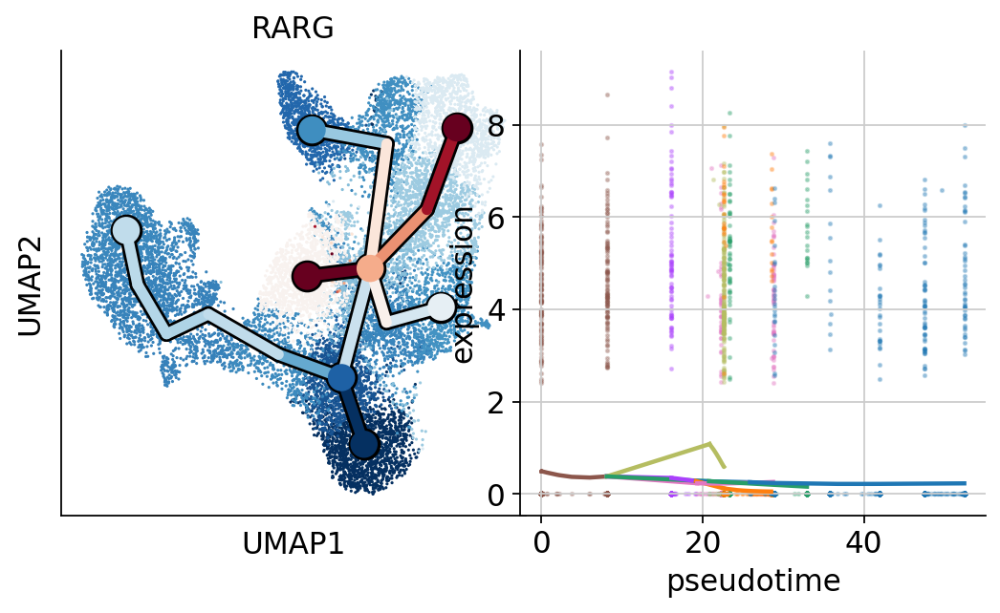

In [59]:
extra = [
#    'FOSL1',
    'FOSL2', 'FOS', 'FOSB',
    'FOXO1',
    'ETV4',
    'PBX1',
    'PBX3',
    'NFIA',
    'NFIB',
    'RARG'
]

for gene in extra:
    scf.pl.single_trend(rna, gene, wspace=-.15, save="_extra_" + gene + "_" + name + ".pdf")

In [49]:
#scf.pl.single_trend(rna, "FOSL1", wspace=-.15)

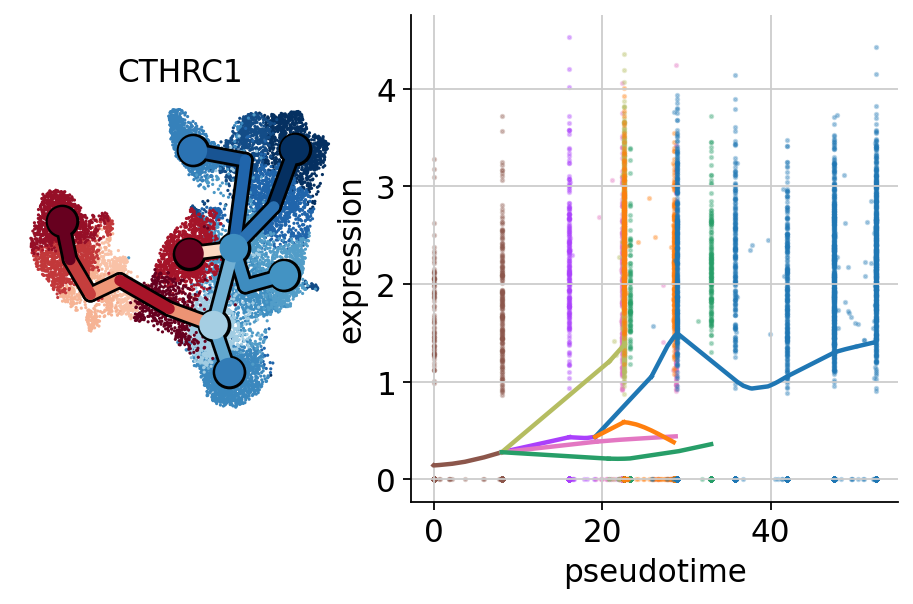

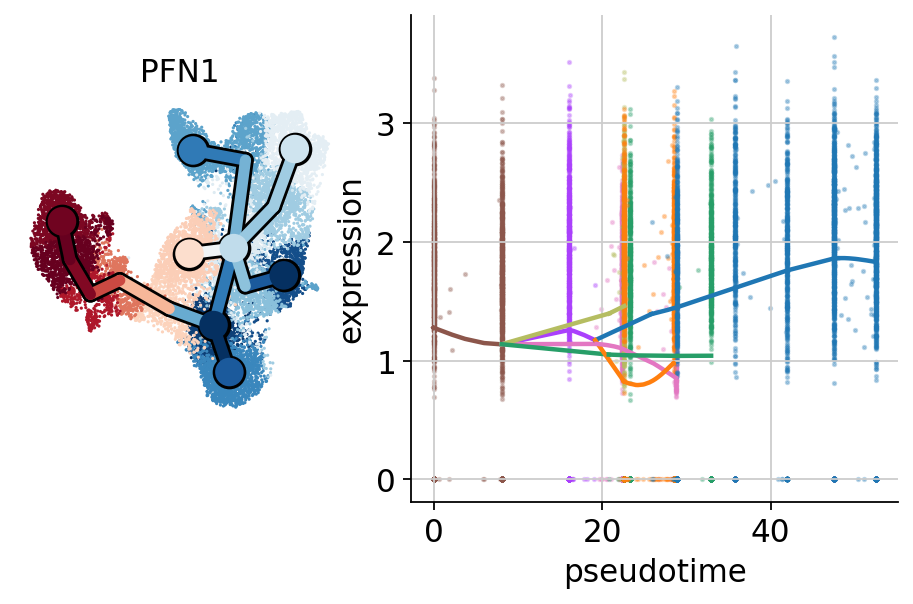

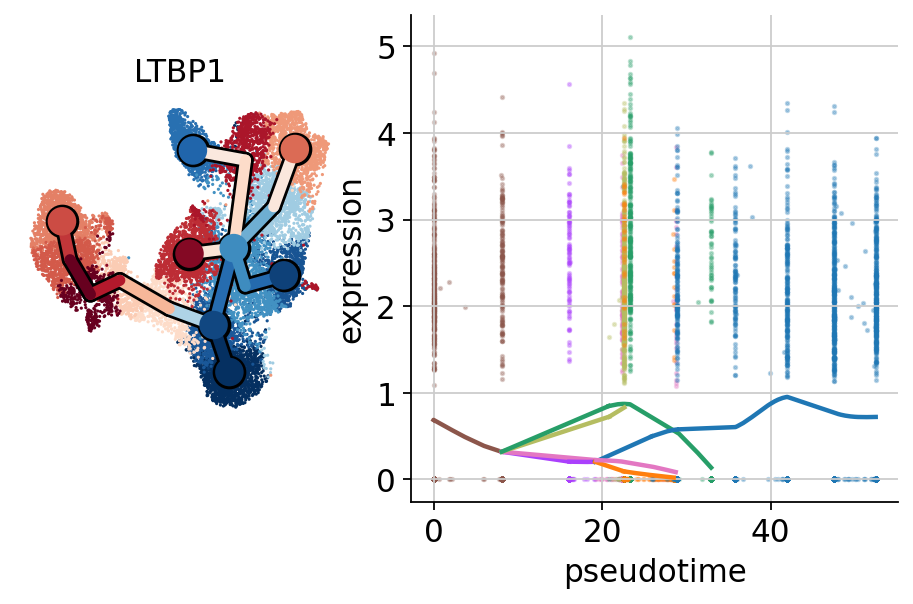

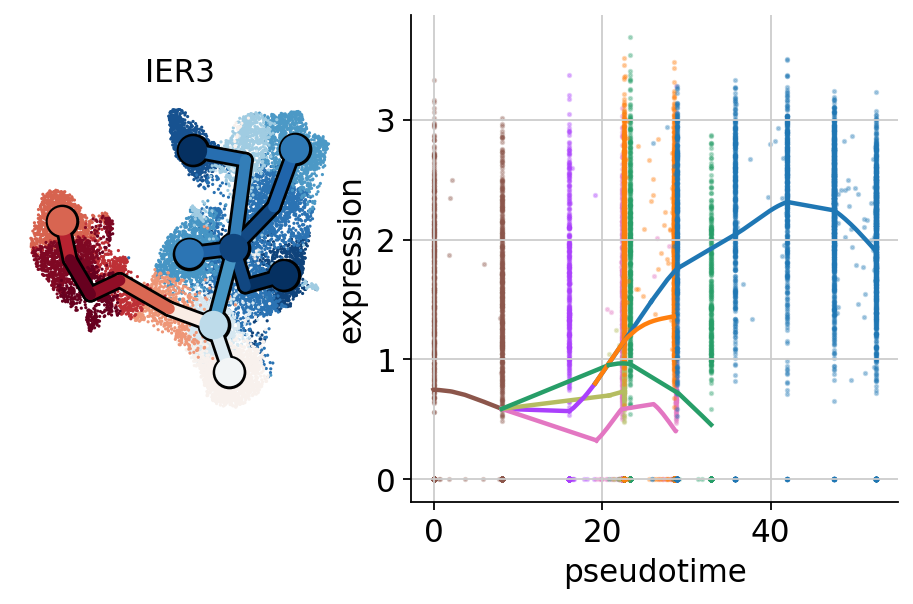

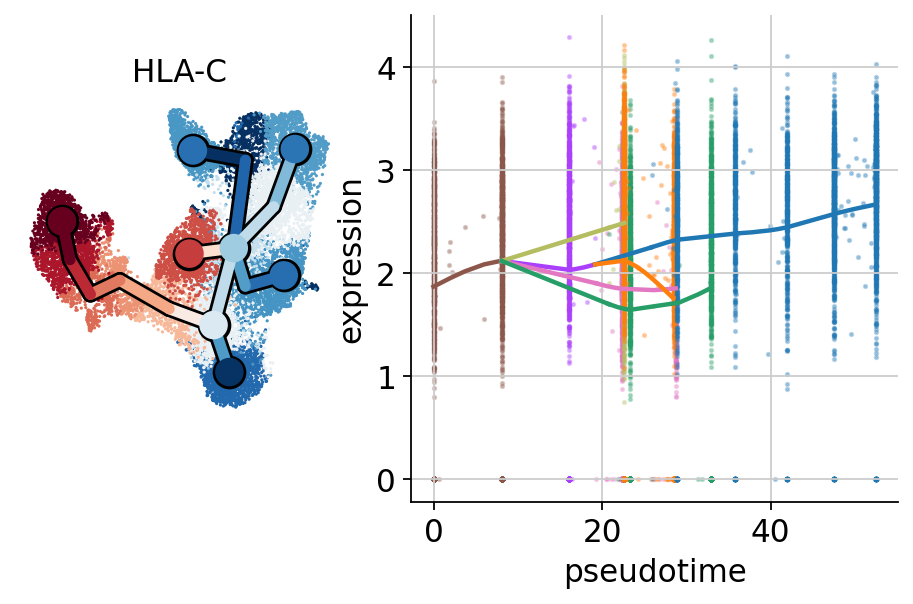

...

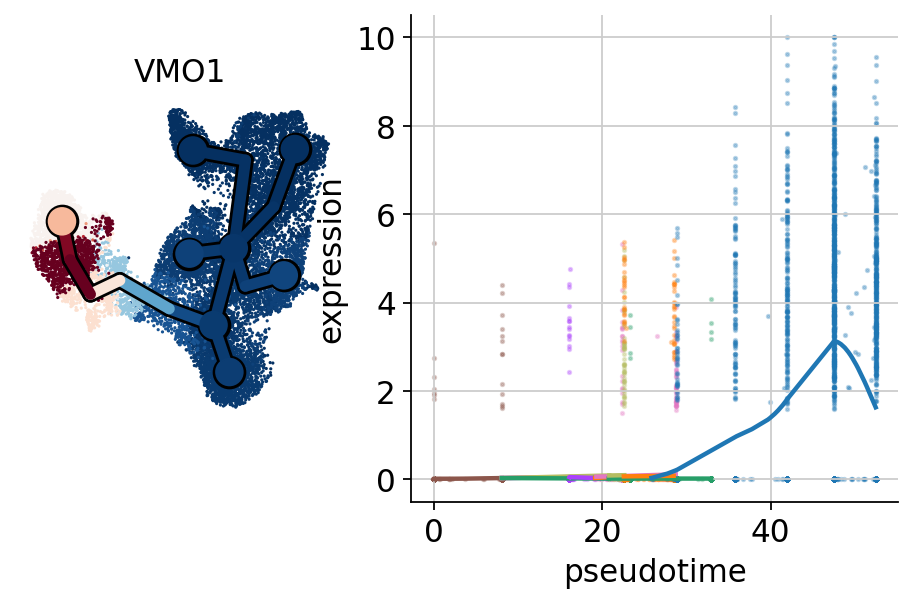

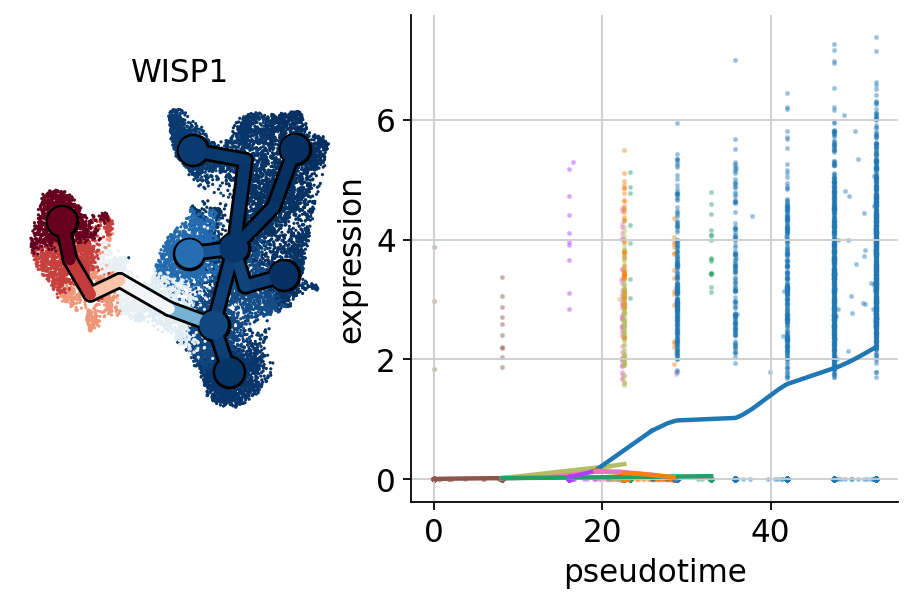

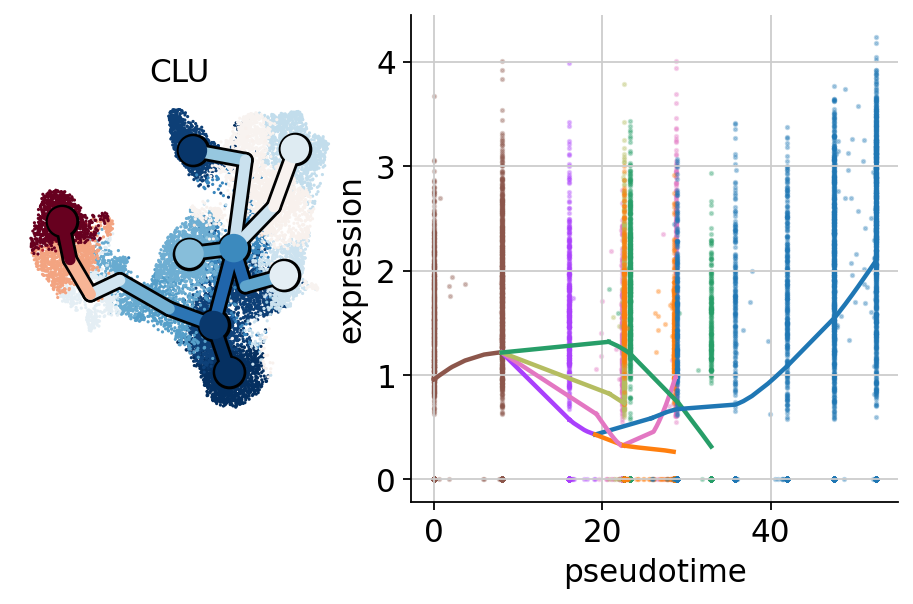

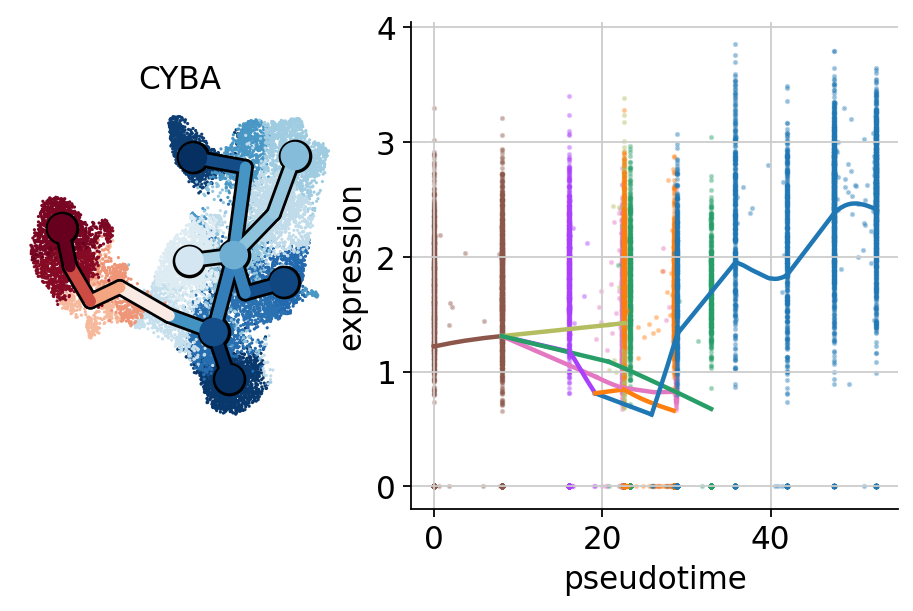

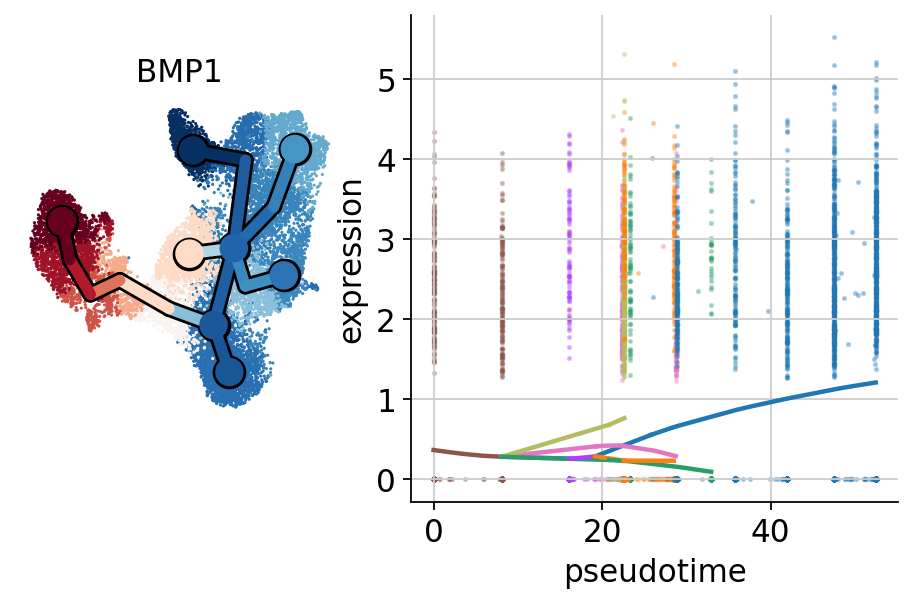

In [252]:
# Plot early, intermediate and late genes
sc.set_figure_params(figsize=(2, 4), frameon=False)

intermediate = [    
    'TNFRSF11B',
    'STC1',
    'LOXL2',
    'IDO1'
]

early = [    
    'CTHRC1',
    'PFN1',
    'LTBP1',
    'IER3',
    'HLA-C',
    'ADAMTS2',
    'TPM2',
    'HIF1A',
    'RABAC1',
    'ACTN1',
    'LY6E',
    'SLC39A14',
    'EPAS1',
    'WARS'
]

late = [
    'FBXO32',
    'VMO1',
    'WISP1',
    'CLU',
    'CYBA',
    'BMP1'
]

for gene in early:
    scf.pl.single_trend(rna, gene, wspace=-.15, save="_early_" + gene + "_" + name + ".pdf")

for gene in intermediate:
    scf.pl.single_trend(rna, gene, wspace=-.15, save="_intermediate_" + gene + "_" + name + ".pdf")

for gene in late:
    scf.pl.single_trend(rna, gene, wspace=-.15, save="_late_" + gene + "_" + name + ".pdf")


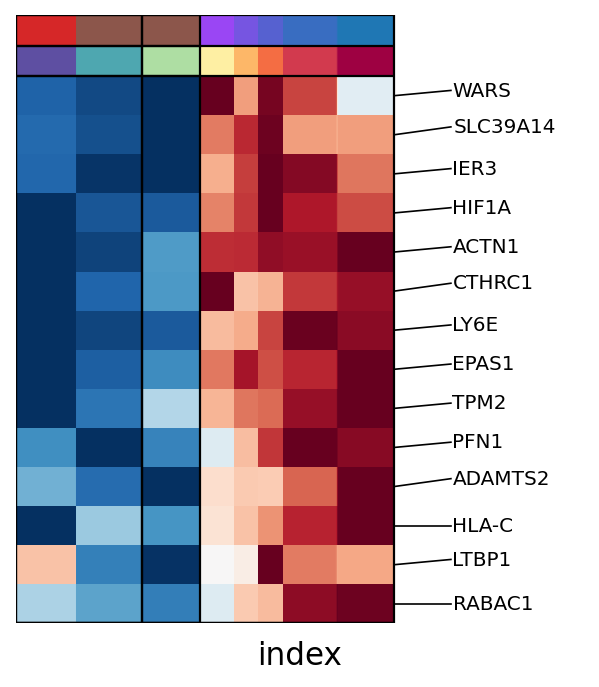

In [320]:
scf.pl.trends(rna,
              features=early,
              n_features=30,  # features to highlight
              
              plot_emb=False,
              show_segs=True,
              annot="milestones",
              root_milestone="prog",
              milestones=["prog", "p1", "p2", "S5"],

              figsize=(5, 5),  # width, height
              pseudo_cmap="Spectral_r",
              save="_trajectory_core_selected_top50_early_" + name + ".pdf"
)


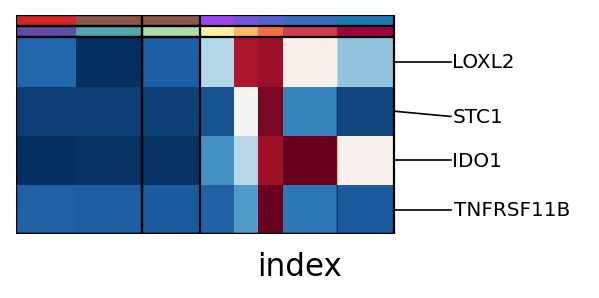

In [321]:
scf.pl.trends(rna,
              features=intermediate,
              n_features=30,  # features to highlight
              
              plot_emb=False,
              show_segs=True,
              annot="milestones",
              root_milestone="prog",
              milestones=["prog", "p1", "p2", "S5"],

              figsize=(5, 1.8),  # width, height
              pseudo_cmap="Spectral_r",
              save="_trajectory_core_selected_top50_intermediate_" + name + ".pdf"
)

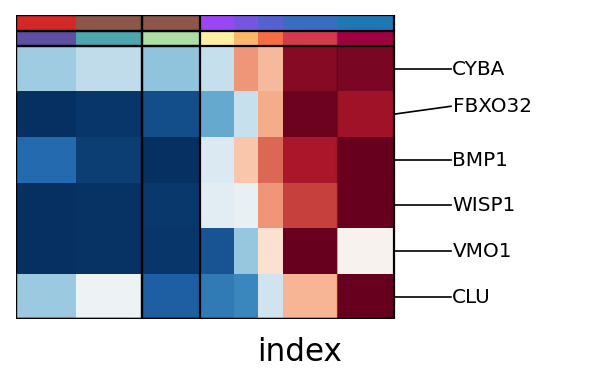

In [322]:
scf.pl.trends(rna,
              features=late,
              title="late",
              n_features=30,  # features to highlight
              
              plot_emb=False,
              show_segs=True,
              annot="milestones",
              root_milestone="prog",
              milestones=["prog", "p1", "p2", "S5"],

              figsize=(5, 2.5),  # width, height
              pseudo_cmap="Spectral_r",
              save="_trajectory_core_selected_top50_late_" + name + ".pdf"
)

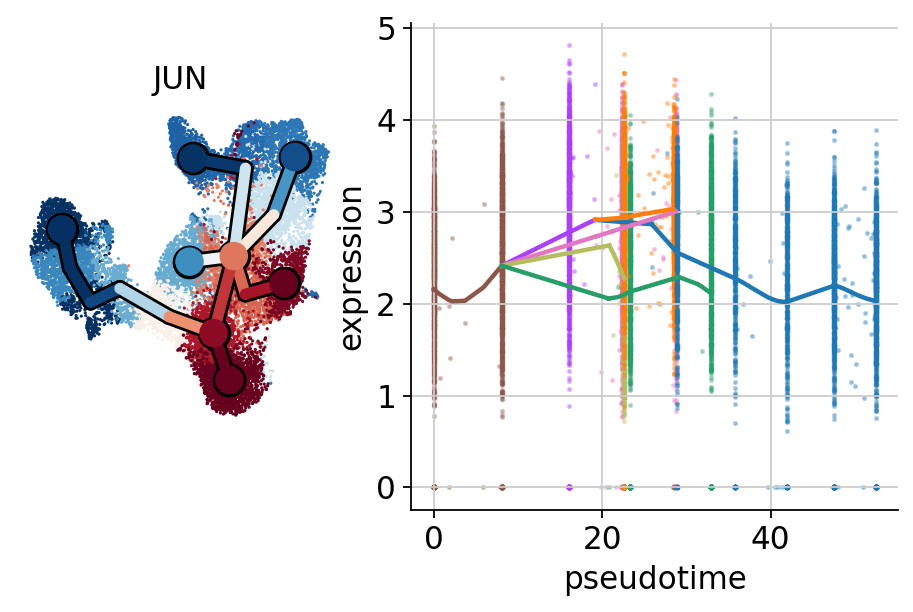

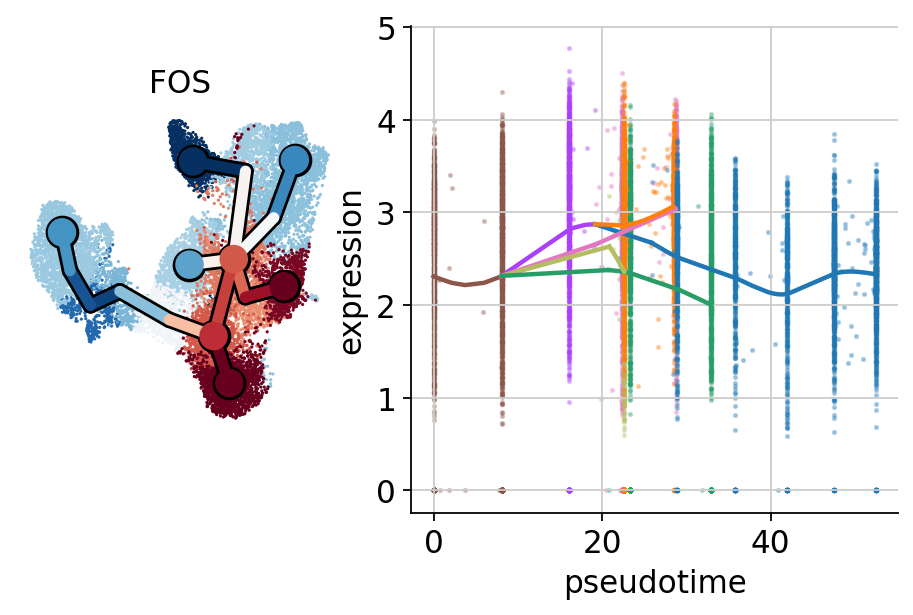

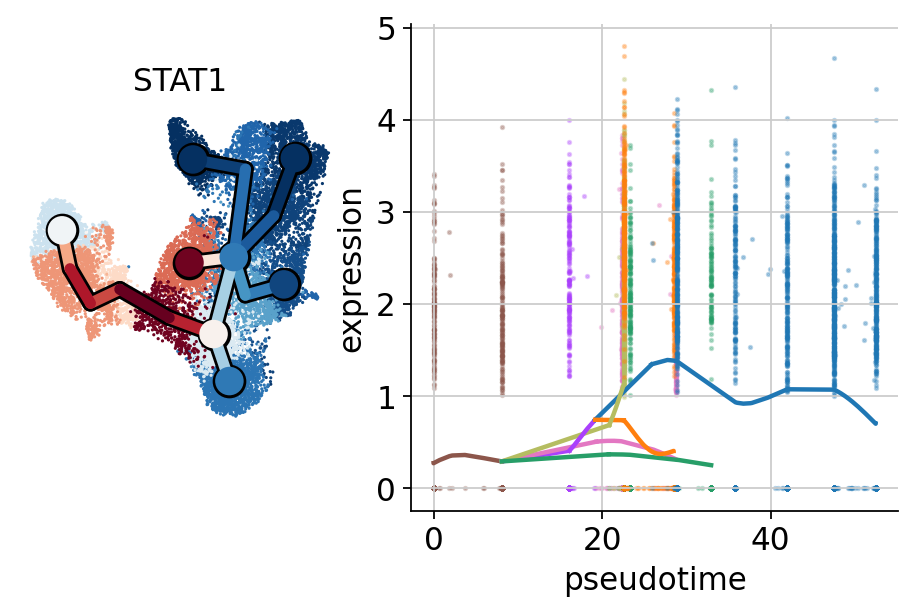

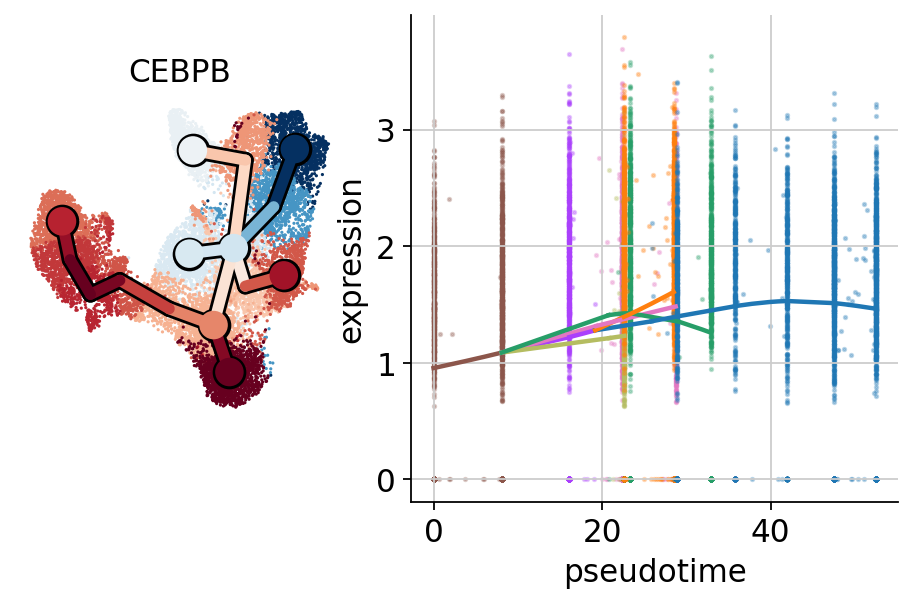

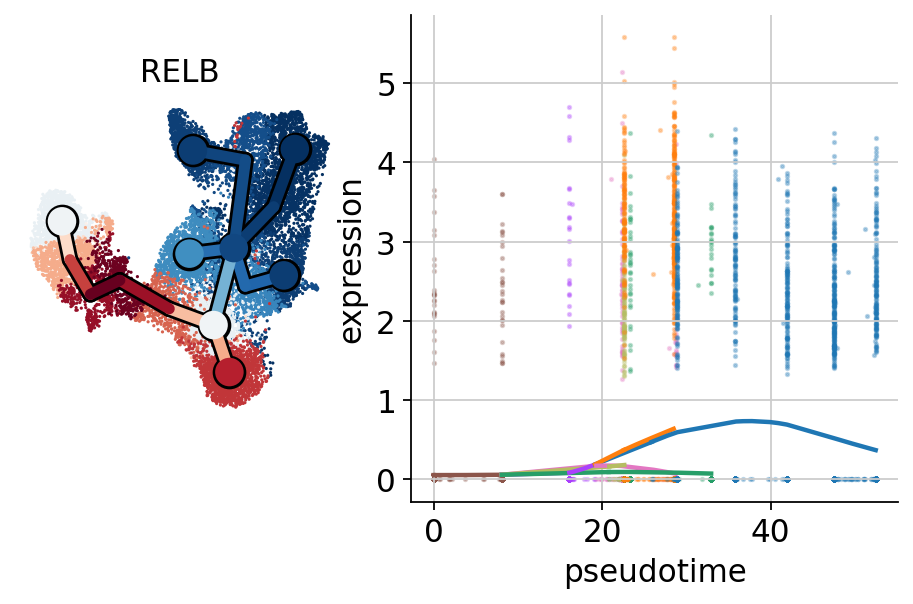

...

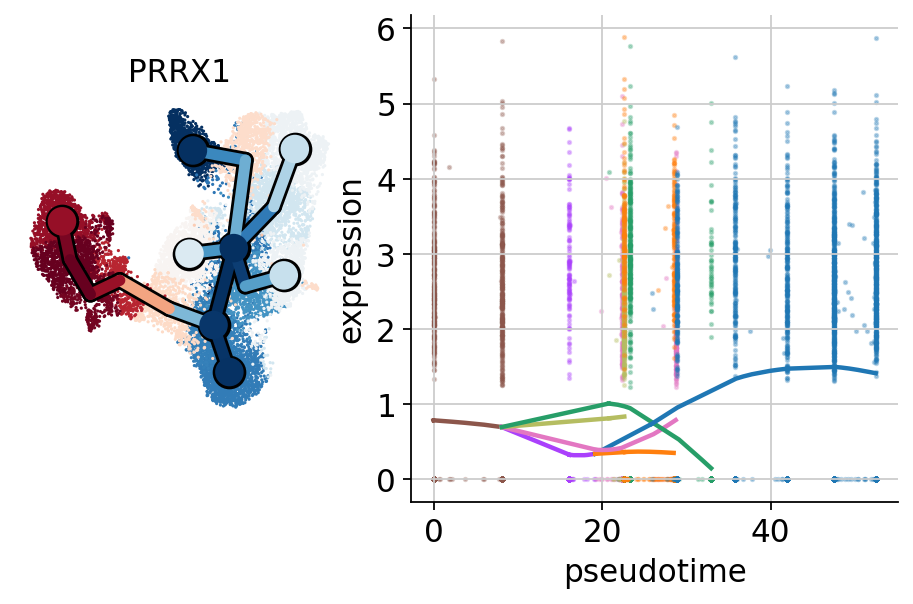

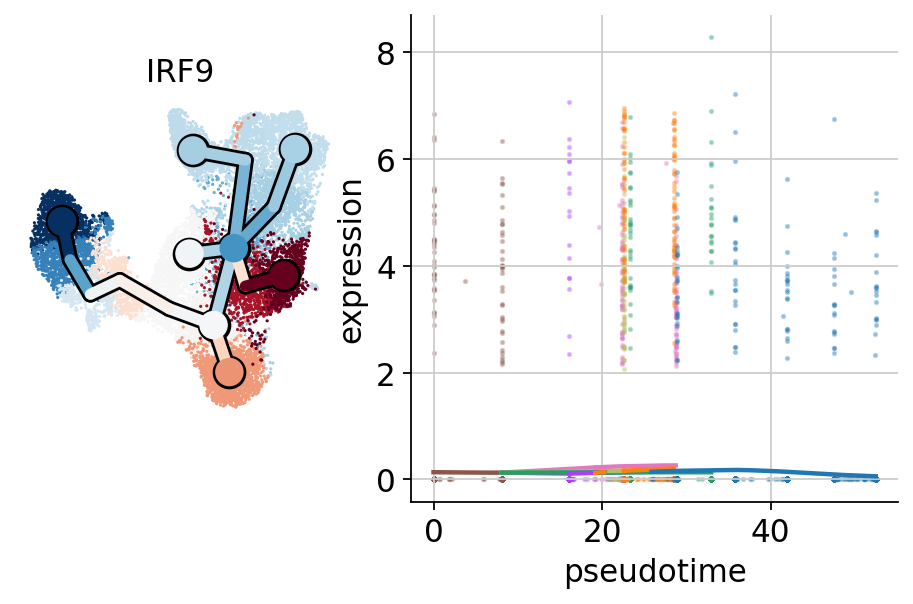

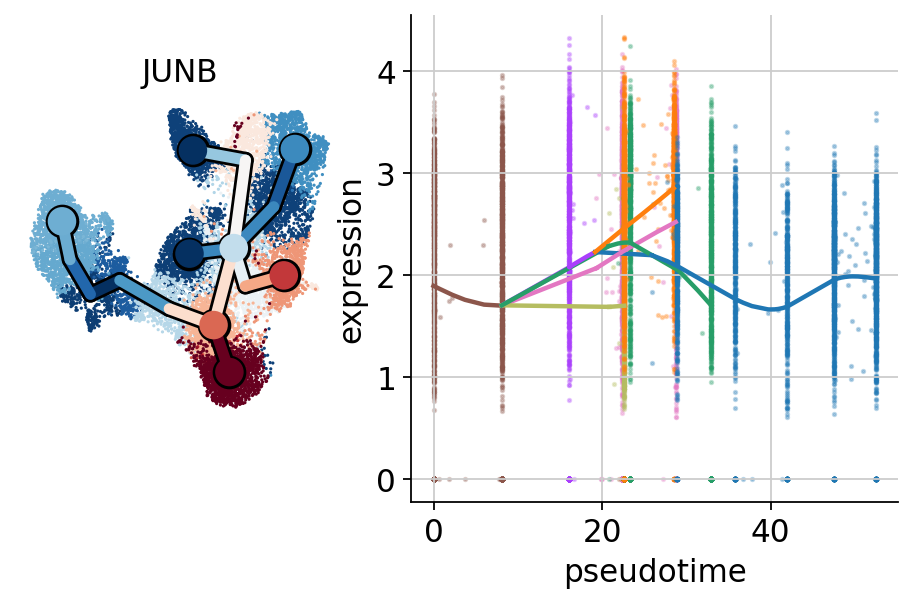

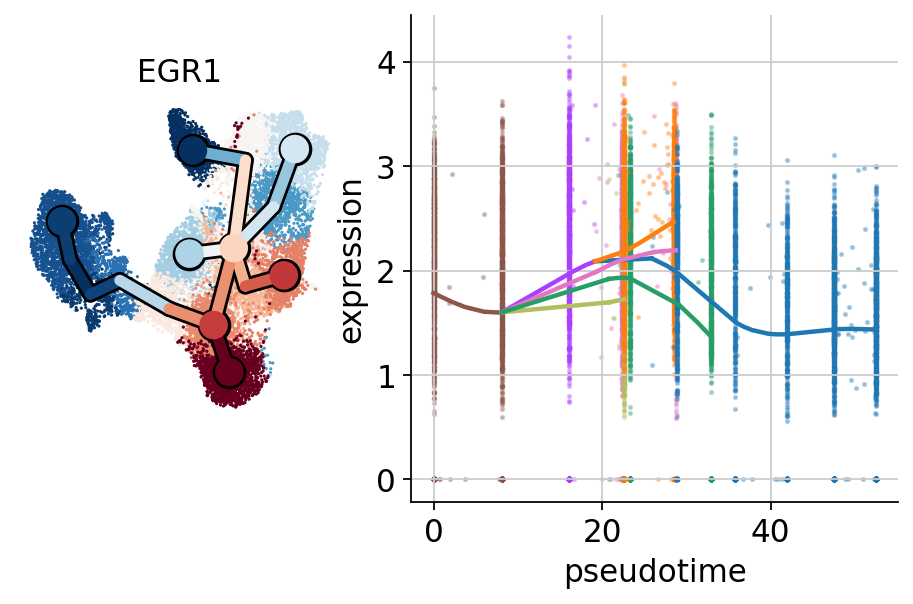

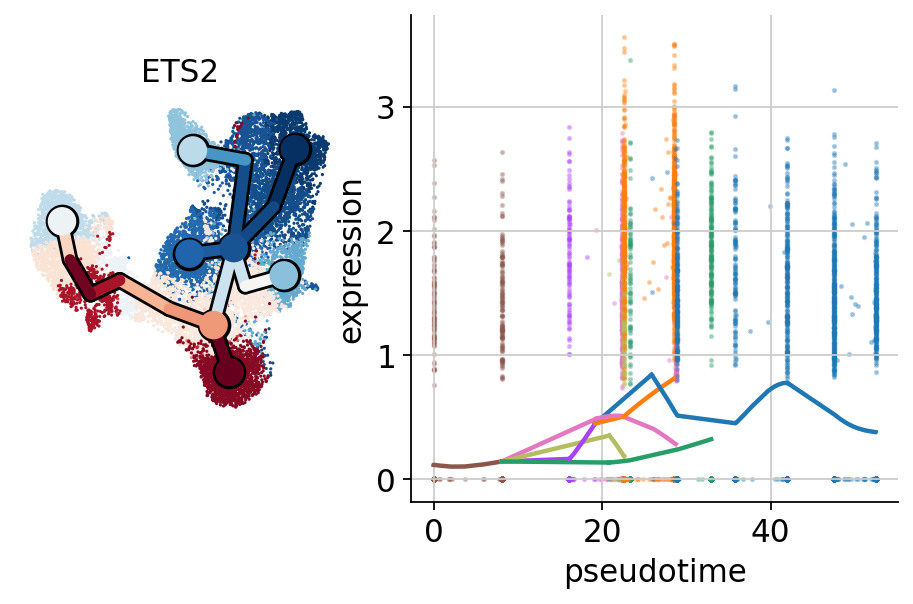

In [239]:
# Genes enriched by regulons @Patrick
sc.set_figure_params(figsize=(2, 4), frameon=False)

# Factor 6 (factor 7 counting from 1)

#scf.set_figure_pubready()
scf.pl.single_trend(rna, "JUN", wspace=-.15)
scf.pl.single_trend(rna, "FOS", wspace=-.15)
scf.pl.single_trend(rna, "STAT1", wspace=-.15, save="_RNA_trajectory_" + name + "_STAT1.pdf")
#scf.pl.single_trend(rna, "TFEC", wspace=-.15)
#scf.pl.single_trend(rna, "BATF", wspace=-.15)
scf.pl.single_trend(rna, "CEBPB", wspace=-.15, save="_RNA_trajectory_" + name + "_CEBPB.pdf")
scf.pl.single_trend(rna, "RELB", wspace=-.15, save="_RNA_trajectory_" + name + "_RELB.pdf")
scf.pl.single_trend(rna, "PRDM1", wspace=-.15, save="_RNA_trajectory_" + name + "_PRDM1.pdf")
scf.pl.single_trend(rna, "FOSL2", wspace=-.15)
scf.pl.single_trend(rna, "KLF4", wspace=-.15)
scf.pl.single_trend(rna, "XBP1", wspace=-.15)
scf.pl.single_trend(rna, "CEBPD", wspace=-.15)
#scf.pl.single_trend(rna, "ELF3", wspace=-.15)
scf.pl.single_trend(rna, "ATF3", wspace=-.15)
scf.pl.single_trend(rna, "PRRX1", wspace=-.15, save="_RNA_trajectory_" + name + "_PRRX1.pdf")
scf.pl.single_trend(rna, "IRF9", wspace=-.15)
scf.pl.single_trend(rna, "JUNB", wspace=-.15)
scf.pl.single_trend(rna, "EGR1", wspace=-.15)
#scf.pl.single_trend(rna, "FOSL1", wspace=-.15)
#scf.pl.single_trend(rna, "HNF4A", wspace=-.15)
#scf.pl.single_trend(rna, "KDM5B", wspace=-.15)
#scf.pl.single_trend(rna, "SPI1", wspace=-.15)
scf.pl.single_trend(rna, "ETS2", wspace=-.15, save="_RNA_trajectory_" + name + "_ETS2.pdf")



In [113]:
# sc.set_figure_params(figsize=(2, 4),frameon=False)
# # scf.set_figure_pubready()
# scf.pl.single_trend(rna, "COL14A1", wspace=-.15)
# scf.pl.single_trend(rna, "NOV", wspace=-.15)
# scf.pl.single_trend(rna, "TNFRSF11B", wspace=-.15)

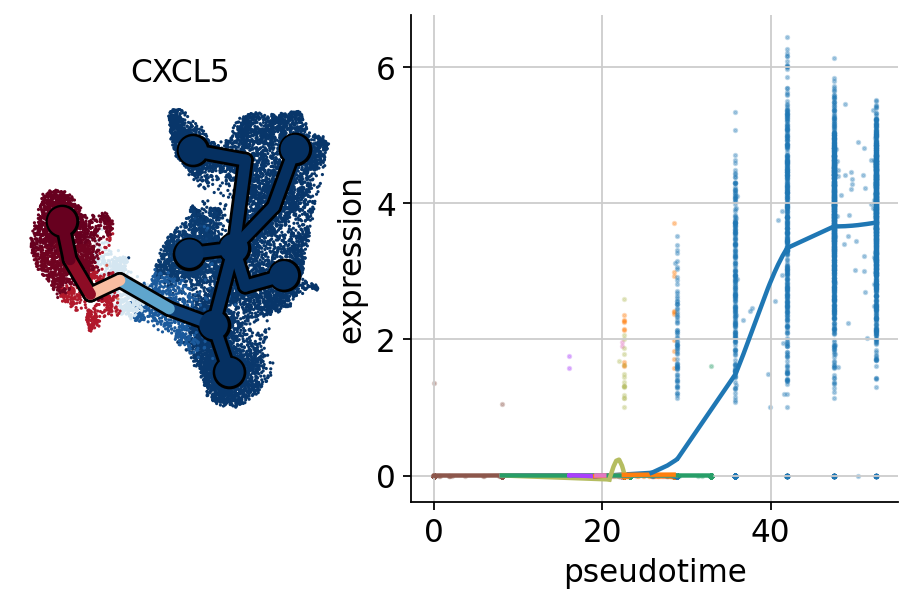

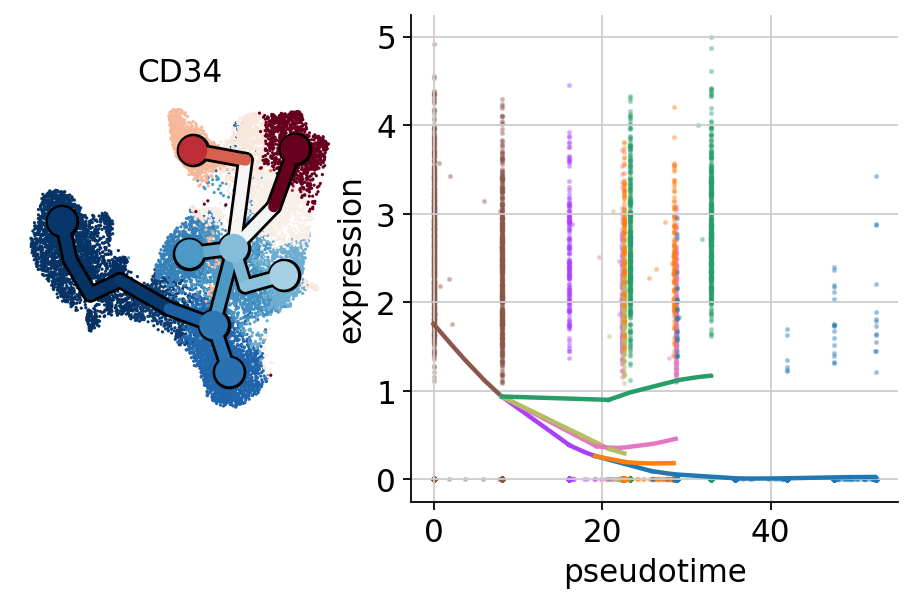

In [114]:


sc.set_figure_params(figsize=(2, 4),frameon=False)
# scf.set_figure_pubready()
scf.pl.single_trend(rna, "CXCL5", wspace=-.15)
scf.pl.single_trend(rna, "CD34", wspace=-.15)
#scf.pl.single_trend(rna, "FBXO32", wspace=-.15)
# #scf.pl.single_trend(rna, "GATA1", basis="dendro", wspace=-.25)

In [82]:
# sc.pl.draw_graph(rna, color=["seg","milestones"])

In [267]:
# sc.set_figure_params(dpi_save=300, figsize=(7, 6.5))

# sc.pl.embedding(rna, color=["seg", "milestones"], basis="umap", legend_loc="on data", show=False)


In [84]:
#scf.tl.test_fork(rna, root_milestone="2", milestones=["0", "3", "4", "2"], n_jobs=8, rescale=True)


In [268]:
# scf.pl.trends(rna, 
#                  #root_milestone="2",
#                  #milestones=["0", "2"],
#                  #branch="Ery",
#                  plot_emb=False, ordering="max", return_genes=True)

In [87]:
# print raw count matrix
#print(rna.raw.X[1:20, 1:10])

In [88]:
#print(rna.X[1:20, 1:10])

In [89]:
#scf.tl.root(adata,163)

# palantir diffussion map
High-resolution or continous trajectory inference

In [280]:
adata = rna.copy()

In [281]:
pca_projections = pd.DataFrame(adata.obsm["X_pca"], index=adata.obs_names)


In [282]:
# Run palantir
dm_res = palantir.utils.run_diffusion_maps(pca_projections, n_components=20)

ms_data = palantir.utils.determine_multiscale_space(dm_res, n_eigs=15)


In [283]:
adata.obsm["X_palantir"] = ms_data.values

In [284]:
sc.pp.neighbors(adata, n_neighbors=40, use_rep="X_palantir")

In [285]:
sc.tl.umap(adata)

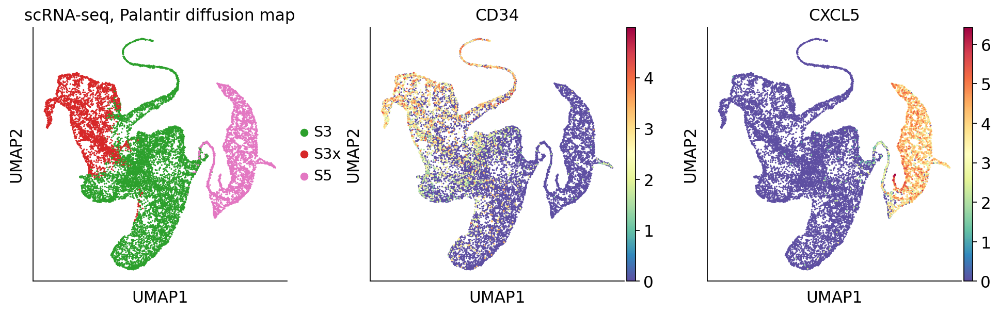

In [290]:
sc.set_figure_params(dpi_save=300, figsize=(4, 4))

sc.pl.umap(adata, color=["annot1", "CD34", "CXCL5"], title="scRNA-seq, Palantir diffusion map", save="_RNA_Palantir_diffusion_" + name + ".pdf")

In [298]:
adata

AnnData object with n_obs × n_vars = 14573 × 6508
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1', 't', 'seg', 'edge', 'milestones'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full', 'p_val', 'A', 'fdr', 'st', 'signi'
    uns: 'annot1_colors', '

In [303]:
adata.obs.index

Index(['AAACGAAGTTCCGTTC-R01', 'AAACGCTGTCGTTGGC-R01', 'AAAGGGCTCCAAGGGA-R01',
       'AAAGTCCGTACGATGG-R01', 'AAATGGAAGGATCATA-R01', 'AACAAAGTCTTGCGCT-R01',
       'AACAACCAGTCTGGTT-R01', 'AACACACAGGGACACT-R01', 'AACAGGGTCAACTGAC-R01',
       'AACAGGGTCACACCGG-R01',
       ...
       'TTTCATGCAGGTTCGC-R13', 'TTTCCTCAGAATCGCG-R13', 'TTTCCTCAGCAGGCAT-R13',
       'TTTCCTCCATAGAAAC-R13', 'TTTCCTCTCTAGTCAG-R13', 'TTTCGATAGGCTCCCA-R13',
       'TTTGGTTCATTCGATG-R13', 'TTTGGTTGTACTAGCT-R13', 'TTTGGTTTCGTGGACC-R13',
       'TTTGTTGGTCACTACA-R13'],
      dtype='object', name='index', length=14573)

In [304]:
start_cell = adata.obs.index[adata.obsm['X_umap'][:, 0].argmin()]  # leftmost cell on UMAP

In [289]:
# MAGIC imputation
#imputed_X = palantir.utils.run_magic_imputation(adata)

In [306]:
pal_results = palantir.core.run_palantir(
    adata,
    start_cell,
    num_waypoints=500,
    #terminal_states=terminal_states
)

KeyError: 'DM_EigenVectors_multiscaled'

In [261]:
# palantir.plot.plot_diffusion_components(adata)
# plt.show()

In [262]:
#sc.pl.draw_graph(adata, color="CD34",color_map="RdBu_r")


In [263]:
scf.tl.tree(adata, method="ppt", Nodes=100, use_rep="palantir",
            device="cpu", seed=1, ppt_lambda=100, ppt_sigma=0.025, ppt_nsteps=200)

inferring a principal tree --> parameters used 
    100 principal points, sigma = 0.025, lambda = 100, metric = euclidean
    fitting:  86%|████████▌ | 171/200 [00:18<00:03,  9.42it/s]
    converged
    finished (0:00:18) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


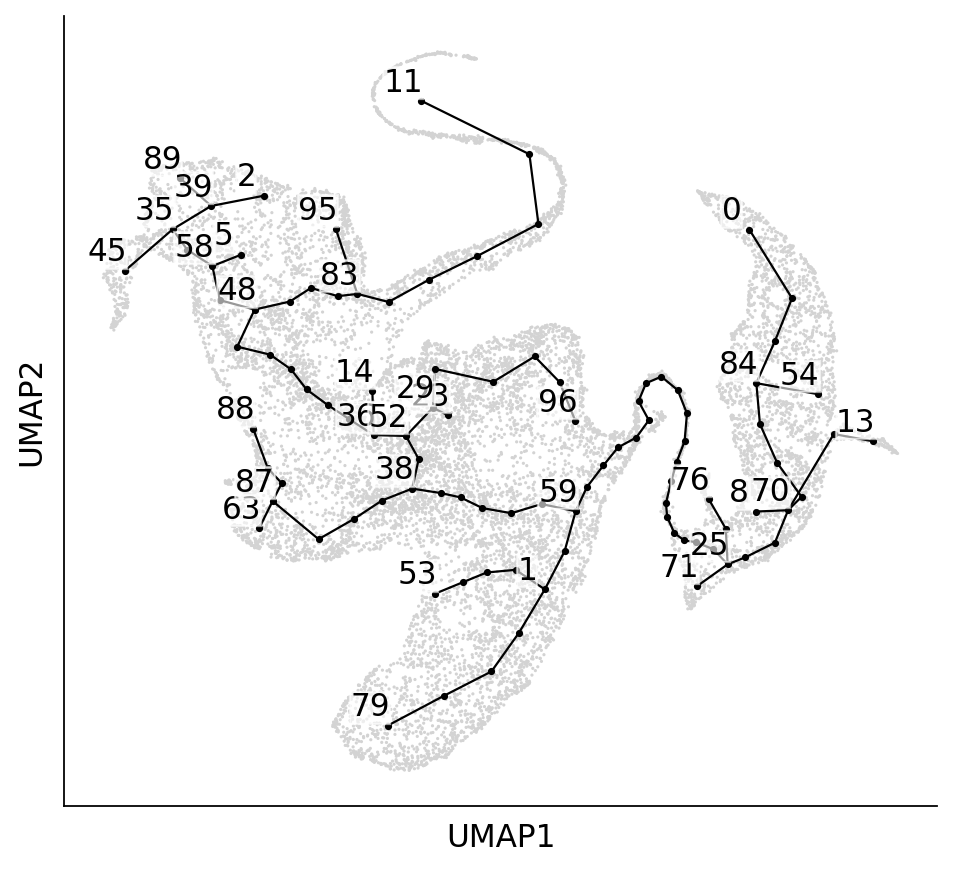

In [270]:
scf.pl.graph(adata, forks=True, tips=True, size_nodes=5, linewidth=1)

In [271]:
scf.tl.root(adata, 45)  # midpoint of CD34 cluster

node 45 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.


In [272]:
# Estimate pseudo-time
scf.tl.pseudotime(adata, n_jobs=1, n_map=100, seed=42)  # weird warnings


projecting cells onto the principal graph
    mappings: 100%|██████████| 100/100 [20:31<00:00, 12.31s/it]


ValueError: Unable to coerce to DataFrame, shape must be (89, 30): given (89, 33)

In [ ]:

scf.pl.trajectory(adata, scale_path=0.3, color_cells="annot1", cmap_seg="Spectral", save="_RNA_Palantir_trajectory_S3S5.pdf", title="scFates trajectory")

In [ ]:
sc.set_figure_params(dpi_save=300, figsize=(6, 5.5))

sc.pl.umap(adata, color=["t"], title="scRNA-seq, Palantir, scFates pseudo-time",
           #save="_RNA_Palantir_diffusion.pdf"
           #color_map="Spectrum_r"

           save="_RNA_Palantir_scFates_pseudotime_" + name + ".pdf"
)

In [ ]:
# Copy pseudo-time estimate to original AnnData object
rna.obs['t'] = adata.obs.t

In [ ]:
sc.pl.umap(rna, color=["t"],
           title="scRNA-seq, Palantir, scFates pseudo-time",
           #save="_RNA_Palantir_diffusion.pdf"
           #color_map="Spectrum_r"
           save="_RNA_Palantir_scFates_pseudotime_oriUMAP_" + name + ".pdf"
)

## Dendrogram visualizations

In [ ]:
# scf.tl.dendrogram(adata)

In [ ]:
# sc.set_figure_params(dpi_save=300, figsize=(3, 7))

# scf.pl.dendrogram(adata, color="annot1", linewidth_seg=1, tree_behind=True, alpha_seg=0.8, title="", save="_RNA_scFates_S3S5.pdf")


In [ ]:
#adata

In [ ]:
# scf.set_figure_pubready()

# scf.pl.single_trend(adata, "CXCL5", basis="dendro", wspace=-.25,
#                     #save="_E2.pdf"
# )

In [ ]:
#adata.obs.seg

In [ ]:
# Tree pseudotime association tests, per segment.
# Long runtime
#scf.tl.test_association(adata, n_jobs=6)  # memory intensive per job, ~6GB per job

In [ ]:
#scf.tl.fit(adata, n_jobs=4)

In [ ]:
# palantir.plot.plot_palantir_results(adata, s=3)
# plt.show()

In [ ]:
# sc.set_figure_params(dpi_save=300, figsize=(7, 7))

# scf.pl.milestones(adata)

In [ ]:
# draw Formilestonestlas2 embedding using 2 first PCs as initial positions
#adata.obsm["X_pca2d"]=adata.obsm["X_pca"][:,:2]
#sc.tl.draw_graph(adata, init_pos='X_pca2d')

In [ ]:
#sc.pl.draw_graph(adata, color="CD34", color_map="RdBu_r")

# Tests of single trajectory approach

In [ ]:

# On 
#scf.tl.curve(adata, Nodes=30, use_rep="X_umap", ndims_rep=2)

#scf.pl.graph(adata, basis="umap")